In [1]:
from Bio import SeqIO
import glob
from gzip import open as gopen
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import matplotlib.patches as mpatches
from matplotlib.legend_handler import HandlerPatch
from matplotlib.lines import Line2D
import numpy as np
from numpy import average, median
from scipy.stats import mannwhitneyu as mwu
from scipy.stats import kruskal, wilcoxon
from statsmodels.stats.multitest import multipletests
from scipy.spatial.distance import euclidean
from scipy import stats
from os import path
import hashlib
from Bio import SeqIO
from scipy.stats import norm
from scipy.optimize import curve_fit
from scipy import asarray as ar,exp
from scipy import optimize
from Bio.KEGG import REST
from Bio.KEGG import Enzyme
from collections import Counter
from itertools import chain
from sklearn import linear_model
from sklearn.model_selection import train_test_split 
from qiime2 import Artifact

%matplotlib inline

**Filter and subset tables**

In [4]:
# Remove Mitochondria, Chloroplast
!qiime taxa filter-table \
  --i-table dada/table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-exclude Mitochondria,Chloroplast,Eukaryota,mitochondria,chloroplast,eukaryota \
  --o-filtered-table temp.qza

# Remove low frequency features
!qiime feature-table filter-features \
  --i-table temp.qza \
  --p-min-frequency 30 \
  --o-filtered-table dada/table.filtered.qza

!qiime feature-table summarize \
  --i-table dada/table.filtered.qza \
  --o-visualization dada/table.filtered.qzv

!qiime feature-table filter-samples \
  --i-table dada/table.filtered.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] IN ('water')" \
  --o-filtered-table dada/table.water.qza

!qiime feature-table filter-samples \
  --i-table dada/table.filtered.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] IN ('epiphyte')" \
  --o-filtered-table dada/table.epiphyte.qza

table = Artifact.load('dada/table.epiphyte.qza').view(pd.DataFrame)
water = Artifact.load('dada/table.water.qza').view(pd.DataFrame)
table = table.loc[:,[i for i in table.columns if i not in water.columns.tolist()]]
table.index.name = '#SampleID'
table.transpose().to_csv('temp',sep='\t')
!biom convert -i temp -o temp.biom --table-type="OTU table" --to-hdf5
!qiime tools import \
  --input-path temp.biom \
  --type 'FeatureTable[Frequency]' \
  --input-format BIOMV210Format \
  --output-path dada/table.epiphyte.no_water.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('0tp')" \
  --o-filtered-table dada/table.0tp.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('3tp')" \
  --o-filtered-table dada/table.3tp.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('5tp')" \
  --o-filtered-table dada/table.5tp.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('8tp')" \
  --o-filtered-table dada/table.8tp.qza

!qiime taxa collapse \
  --i-table dada/table.epiphyte.no_water.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 4 \
  --o-collapsed-table dada/table.epiphyte.no_water.l4.qza

Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: dada/table.filtered.qza
Saved FeatureTable[Frequency] to: dada/table.water.qza
Saved FeatureTable[Frequency] to: dada/table.epiphyte.qza
Imported temp.biom as BIOMV210Format to dada/table.epiphyte.no_water.qza
Saved FeatureTable[Frequency] to: dada/table.0tp.qza
Saved FeatureTable[Frequency] to: dada/table.3tp.qza
Saved FeatureTable[Frequency] to: dada/table.5tp.qza
Saved FeatureTable[Frequency] to: dada/table.8tp.qza
Saved FeatureTable[Frequency] to: dada/table.epiphyte.no_water.l4.qza


**Bar plot and alpha rarefaction**

In [10]:
!mkdir rarefaction_curve_and_barplot

!qiime taxa barplot \
  --i-table dada/table.epiphyte.no_water.qza \
  --i-taxonomy dada/taxonomy.qza \
  --m-metadata-file metadata.tsv \
  --o-visualization rarefaction_curve_and_barplot/barplot.qzv

!qiime diversity alpha-rarefaction \
  --i-table dada/table.epiphyte.no_water.qza  \
  --i-phylogeny dada/rooted-tree.qza \
  --p-max-depth 7000 \
  --m-metadata-file metadata.tsv \
  --o-visualization rarefaction_curve_and_barplot/curve.qzv



mkdir: cannot create directory ‘rarefaction_curve_and_barplot’: File exists
Saved Visualization to: rarefaction_curve_and_barplot/barplot.qzv
Saved Visualization to: rarefaction_curve_and_barplot/curve.qzv


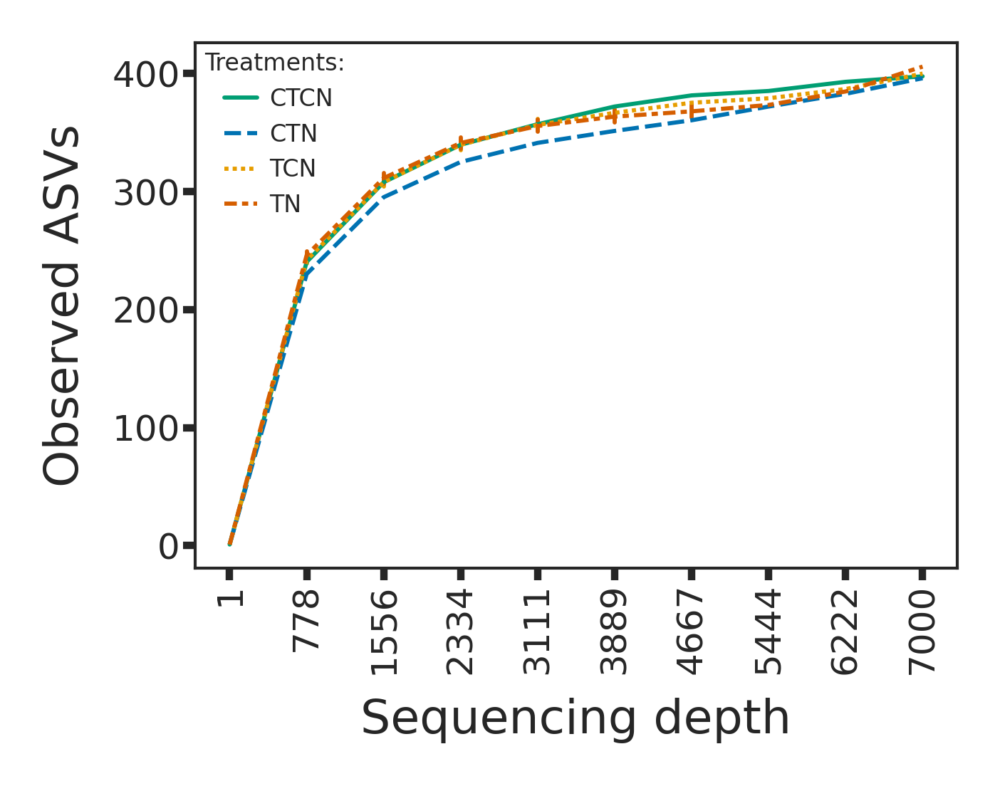

In [119]:
qza = 'rarefaction_curve_and_barplot/curve.qzv'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/observed_features.csv'
otus = pd.read_csv(inf,index_col=0, sep=',')
!rm -r $digest

cols = [col for col in otus.columns if 'iter' not in col]
mean,data = otus[cols],pd.DataFrame(columns=cols)
depths = [col.split('_')[0] for col in otus.columns if 'depth' in col]
otus = otus.drop(cols,axis=1)
otus.columns = depths
for depth in depths:
    mean['ASV'] = otus[depth].mean(axis=1)
    mean['depth']= depth.split('-')[-1]
    data = pd.concat([data,mean])

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
fig,ax = plt.subplots(figsize=(2.5,2),dpi=600,tight_layout=True)
sns.set(style='ticks',rc={"lines.linewidth":0.7,"axes.linewidth":0.5})
sns.lineplot(x='depth',y='ASV',data=data,palette=pal,hue='Treatment',sort=False,err_style='bars',dashes=True,style='Treatment')

ax.set_xlabel('Sequencing depth',fontsize=8)
ax.set_ylabel('Observed ASVs',fontsize=8)
ax.tick_params(axis='x', labelrotation=90)
ax.tick_params(axis='both',which='major',length=2,pad=0.5,labelsize=6)
handles, labels = ax.get_legend_handles_labels()
ax.legend(title='Treatments:',title_fontsize=4,handles=handles[0:],labels=labels[0:],fontsize=4,frameon=False,numpoints=4,borderaxespad=0,handletextpad=0.2,loc=2)
plt.savefig('FigS1.png', bbox_inches='tight')

**Order level relative abundances**

In [114]:
from qiime2 import Artifact

narrow = pd.DataFrame(columns = ['taxon','order','Treatment','TP','SourceSite','Relative Abundance'])

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

!qiime feature-table relative-frequency \
    --i-table dada/table.epiphyte.no_water.l4.qza \
    --o-relative-frequency-table temp.qza
    
a = Artifact.load('temp.qza')
table = a.view(pd.DataFrame).transpose()

for taxon in table.index.tolist():
    for col in table:
        treatment = metadata.at[col,'Treatment']
        tp = metadata.at[col,'TP']
        site = metadata.at[col,'SourceSite']
        narrow.loc[len(narrow)] = [taxon,taxon.split('__')[-1],treatment,tp,site,table.at[taxon,col]]

!rm temp.qza

Saved FeatureTable[RelativeFrequency] to: temp.qza


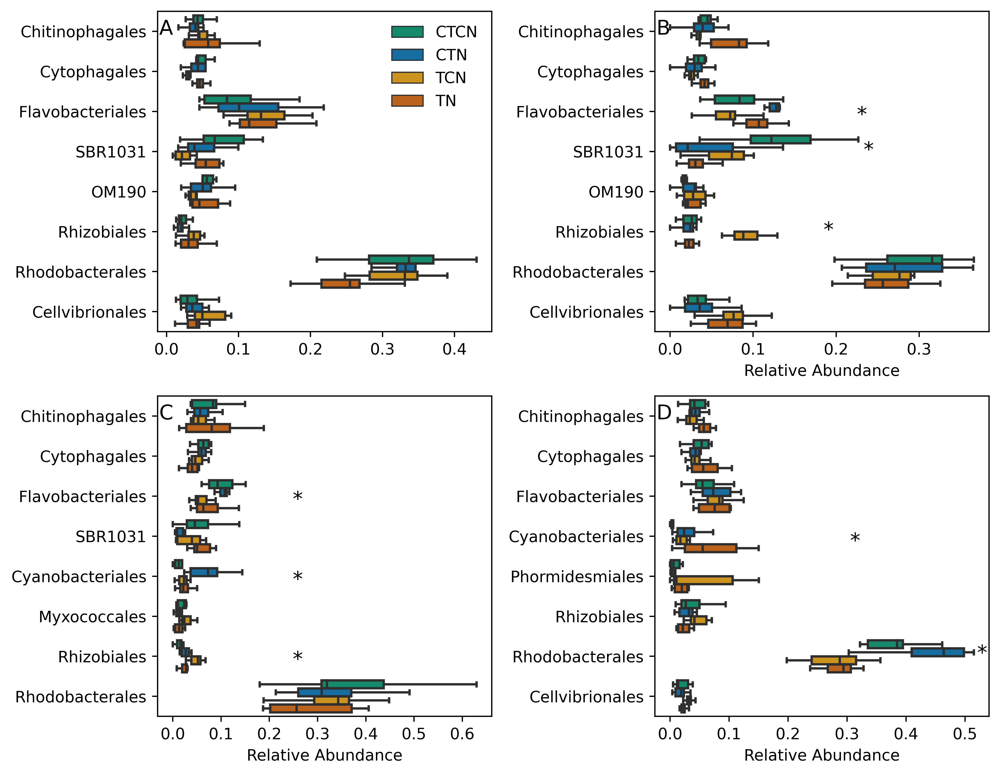

In [118]:
fig, axes = plt.subplots(nrows = 2, ncols=2, dpi=600, figsize=(9,7),tight_layout=True)
ax_labels = ['A','B','C','D']
timepoints = [0,3,5,8]

for row in axes:
    for ax in row:
        
        tp = timepoints.pop(0)

        averages = {}

        for order in set(narrow.loc[narrow.TP==tp].order):
            if 'NA' in order:
                continue
            averages[order] = np.average(narrow.loc[((narrow.order==order)&(narrow.TP==tp))]['Relative Abundance'])


        top_orders = [i[0] for i in sorted(averages.items(), key=lambda h: h[1], reverse=True)[:8]]

        a = narrow.loc[(narrow.order.isin(top_orders) & (narrow.TP==tp))]

        a.pivot_table(index=['order','Treatment']).to_csv('timepoint_%i_top_orders.tsv' % tp,sep='\t')

        sns.boxplot(x='Relative Abundance',y='order',data=a,hue='Treatment',hue_order=['CTCN','CTN','TCN','TN'],
                      ax=ax,palette=['#009e73','#0072b2','#e69d00','#d55e00'],showfliers=False)

        if len(ax_labels) < 4:
            ax.legend().remove()
        else:
            ax.set_xlabel('')

        ax.set_ylabel('')
        ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

        if tp == 0:
            ax.legend(frameon=False)
        elif tp == 3:
            ax.annotate('*',xy=(0.6,0.73),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0.62,0.62),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0.5,0.37),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        elif tp == 5:
            ax.annotate('*',xy=(0.4,0.73),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0.4,0.48),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0.4,0.23),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        elif tp == 8:
            ax.annotate('*',xy=(0.58,0.6),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0.96,0.25),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

        
plt.savefig('Fig1.png',bbox_inches='tight')

**Test significant differences among treatments for each order in each time point**

In [38]:
from scipy.stats import kruskal
from statsmodels.stats.multitest import multipletests

kruskal_results = pd.DataFrame(columns=['Order','TP','u','p'])

for order in set(narrow.order):
    for tp in set(narrow.TP):
        n = narrow.loc[((narrow.order==order)&(narrow.TP==tp))]
        sets = []
        for t in set(n.Treatment):
            sets.append(n.loc[n.Treatment==t]['Relative Abundance'])
        try:
            kout = kruskal(*sets)
        except:
            continue
        kruskal_results.loc[len(kruskal_results)] = [order,tp]+list(kout)
kruskal_results['q'] = list(multipletests(kruskal_results.p,method='fdr_bh'))[1] 

**Time point 0**

In [38]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==0))]

,Order,TP,u,p,q
27,Bacillales,0,11.111422,0.011138,0.049881
31,Ferrovibrionales,0,14.450943,0.002351,0.019532
92,SZB50,0,12.361164,0.006243,0.038719
105,Puniceispirillales,0,14.212500,0.002630,0.020835
125,JTB23,0,11.664189,0.008627,0.045981
133,BD2-11_terrestrial_group,0,20.466453,0.000136,0.008746
137,Phycisphaerales,0,14.158784,0.002697,0.021043
141,Dadabacteriales,0,24.052715,0.000024,0.005176
217,Polyangiales,0,17.150676,0.000658,0.013914
229,Opitutales,0,13.625225,0.003462,0.025473


**Time point 3**

In [42]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==3))].sort_values('Order')

,Order,TP,u,p,q
98,Alphaproteobacteria_Incertae_Sedis,3,24.041291,0.000024,0.005176
165,Alteromonadales,3,15.069871,0.001758,0.016765
499,Bdellovibrionales,3,14.343243,0.002473,0.020218
331,Calditrichales,3,17.312741,0.000609,0.013646
25,Candidatus_Peregrinibacteria,3,15.246327,0.001618,0.016337
143,Dadabacteriales,3,15.773053,0.001262,0.016337
79,Flavobacteriales,3,13.538739,0.003605,0.026151
235,Gracilibacteria,3,17.580561,0.000537,0.013163
295,Hydrogenedentiales,3,19.176265,0.000251,0.010789
127,JTB23,3,19.397262,0.000226,0.010593


**Time point 5**

In [54]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==5))].sort_values('Order')

,Order,TP,u,p,q
341,Ardenticatenales,5,15.660553,0.001331,0.016337
357,Balneolales,5,11.589013,0.008932,0.046940
66,Caulobacterales,5,15.412328,0.001496,0.016337
268,Cellvibrionales,5,15.319471,0.001563,0.016337
310,Chromatiales,5,13.819198,0.003162,0.023947
272,Coxiellales,5,15.915965,0.001180,0.016337
288,Cyanobacteriales,5,14.470265,0.002330,0.019532
144,Dadabacteriales,5,15.110581,0.001725,0.016757
80,Flavobacteriales,5,11.516429,0.009237,0.047786
369,Gammaproteobacteria_Incertae_Sedis,5,21.688915,0.000076,0.008746


**Time point 8**

In [62]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==8))].sort_values('Order')

,Order,TP,u,p,q
505,Absconditabacteriales_(SR1),8,11.325843,0.010088,0.048008
282,Acetothermiia,8,16.576908,0.000863,0.015333
339,Ardenticatenales,8,11.291325,0.010251,0.048008
81,Azospirillales,8,11.325843,0.010088,0.048008
37,BD7-11,8,17.738217,0.000498,0.013163
355,Balneolales,8,12.352459,0.006268,0.038719
498,Bdellovibrionales,8,15.804730,0.001243,0.016337
483,CCM11a,8,14.466890,0.002334,0.019532
49,Caenarcaniphilales,8,14.661399,0.002130,0.019532
286,Cyanobacteriales,8,15.996847,0.001136,0.016246


**Diversity, all samples**

In [68]:
depth=5000

!qiime diversity core-metrics-phylogenetic \
  --i-phylogeny dada/rooted-tree.qza \
  --i-table dada/table.filtered.qza \
  --p-sampling-depth $depth \
  --m-metadata-file metadata.tsv \
  --output-dir DIVERSITY_epiphytes_and_water


!qiime diversity pcoa \
  --i-distance-matrix DIVERSITY_epiphytes_and_water/weighted_unifrac_distance_matrix.qza \
  --p-number-of-dimensions 3 \
  --o-pcoa DIVERSITY_epiphytes_and_water/weighted_unifrac_pcoa_results.qza

!qiime feature-table relative-frequency \
  --i-table DIVERSITY_epiphytes_and_water/rarefied_table.qza \
  --o-relative-frequency-table temp.qza

!qiime diversity pcoa-biplot \
  --i-pcoa DIVERSITY_epiphytes_and_water/weighted_unifrac_pcoa_results.qza \
  --i-features temp.qza \
  --o-biplot DIVERSITY_endophytes_and_water/weighted_unifrac_bplot_results.qza

Saved FeatureTable[Frequency] to: DIVERSITY_endophytes_and_water/rarefied_table.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_endophytes_and_water/faith_pd_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_endophytes_and_water/observed_features_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_endophytes_and_water/shannon_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_endophytes_and_water/evenness_vector.qza
Saved DistanceMatrix to: DIVERSITY_endophytes_and_water/unweighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_endophytes_and_water/weighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_endophytes_and_water/jaccard_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_endophytes_and_water/bray_curtis_distance_matrix.qza
Saved PCoAResults to: DIVERSITY_endophytes_and_water/unweighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_endophytes_and_water/weighted_unifrac_pcoa_results.qza
Saved PCoAResults to

In [43]:
qza = 'DIVERSITY_epiphytes_and_water/faith_pd_vector.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/alpha-diversity.tsv'
faithpd = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
def get_fraction(string):
    return metadata.at[string,'Fraction']
def get_treatment(string):
    return metadata.at[string,'Treatment']
def get_site(string):
    return metadata.at[string,'SourceSite']
def get_tp(string):
    return metadata.at[string,'T']

faithpd['Fraction'] = faithpd.index.map(get_fraction)
faithpd['Treatment'] = faithpd.index.map(get_treatment)
faithpd['SourceSite'] = faithpd.index.map(get_site)
faithpd['TP'] = faithpd.index.map(get_tp)
faithpd.index.name = 'sample-id'
faithpd.to_csv('DIVERSITY_epiphytes_and_water/faithpd_anova.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file DIVERSITY_epiphytes_and_water/faithpd_anova.tsv \
    --p-formula "faith_pd ~ Fraction + TP + Treatment + SourceSite" \
    --o-visualization DIVERSITY_epiphytes_and_water/faithpd_anova.qzv

Saved Visualization to: DIVERSITY_epiphytes_and_water/faithpd_anova.qzv


**Nutrient measurements**

In [79]:
!mkdir nutrients

qza = 'DIVERSITY_epiphytes_and_water/faith_pd_vector.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/alpha-diversity.tsv'
faithpd = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

measurements = pd.read_csv('nutrient_measurments.csv')

for ind, row in faithpd.iterrows():
    if not ind.startswith('AS'):
        continue
    treatment = metadata.loc[ind,'Treatment']
    tp = 'T%i' % metadata.loc[ind,'TP']
    temp = metadata.loc[ind,'Temp']
    temp_class = 'lo'
    if temp == 31:
        temp_class = 'hi'
    m = measurements.loc[((measurements.Treatment==treatment)&(measurements.TimePoint==tp))]
    for i,r in m.iterrows():
        faithpd.at[ind,r['Nutrient']] = r['MeanMeasuremnet']
    faithpd.at[ind,'Temp'] = temp
    faithpd.at[ind,'TempClass'] = temp_class
    
faithpd = faithpd.dropna()
faithpd.index.name = 'sample id'
faithpd.to_csv('nutrients/faith_pd_with_water_effect.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file nutrients/faith_pd_with_water_effect.tsv \
    --p-formula "faith_pd ~ PO3 + NO2 + NH4 + NOX + DIN_IUI_ZMT + N_P + TempClass" \
    --o-visualization nutrients/faith_pd_with_water_effect.qzv

mkdir: cannot create directory ‘nutrients’: File exists
Saved Visualization to: nutrients/faith_pd_with_water_effect.qzv


In [41]:
def parse_biplot(qza): ### Unzipping qza biplots
    a = !unzip $qza
    digest = a[1].split('/')[0].replace('  inflating: ','')
    inf = digest + '/data/ordination.txt'
    lines = open(inf,'r').readlines()
    Eigvals = [float(i) for i in lines[1].rstrip().split('\t')]
    Proportion = [float(i) for i in lines[4].rstrip().split('\t')]
    biplot_skiprows = 7
    biplot_skipfoot = len(open(inf,'r').read().split('Site')[1].splitlines()) + 1
    pcoa_skiprows = len(open(inf,'r').read().split('Site')[0].splitlines()) + 1
    pcoa_skipfoot = 4
    pcoa = pd.read_csv(inf, index_col=0, skiprows=pcoa_skiprows, skipfooter=pcoa_skipfoot, header=None, sep='\t',engine='python')
    biplot = pd.read_csv(inf, index_col=0, skiprows=biplot_skiprows, skipfooter=biplot_skipfoot, header=None, sep='\t',engine='python')
    nan_cols = []
    for col in biplot:
        if np.isnan(biplot[col].tolist()[0]):
            nan_cols.append(col)
    if len(nan_cols) > 0:
        biplot = biplot.drop(labels=nan_cols,axis=1)
    !rm -r $digest
    return  pcoa, biplot, Eigvals, Proportion

def get_arrow_coords(axis,axis2,num,biplot): ### Geting coordinats for arrows
    arrow_data = []
    origin = np.zeros_like(biplot.columns)
    biplot['importance'] = biplot.apply(euclidean, axis=1, args=(origin,))
    biplot.sort_values('importance', inplace=True, ascending=False)
    for taxon in biplot.index.tolist()[:num].copy():
        arrow_data.append([taxon,biplot.at[taxon,axis],biplot.at[taxon,axis2]])
    return arrow_data

taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)

No handles with labels found to put in legend.
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


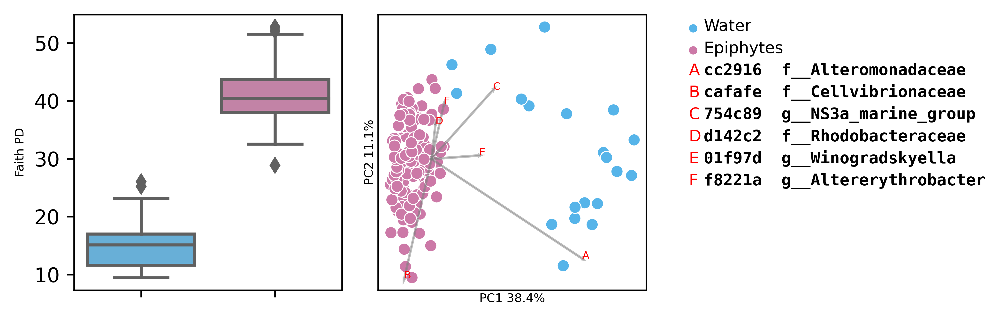

In [44]:
qza = 'DIVERSITY_epiphytes_and_water/weighted_unifrac_bplot_results.qza'
ordination, biplot, Eigvals, Proportion = parse_biplot(qza)

df = pd.concat([ordination,metadata.loc[ordination.index,:]],axis=1)
df.columns = [str(i) for i in df.columns]

fig, axes  = plt.subplots(ncols=3, dpi=600, figsize=(7,2.3), tight_layout=True)

ax = axes[0]

sns.boxplot(x='Fraction',y='faith_pd',data=faithpd,order=['water','epiphyte'],palette=['#56b4e9','#cc79a7'],ax=ax)
ax.legend().remove()
ax.set_ylabel('Faith PD',fontdict={'fontsize': 6})
ax.set_xlabel('')
ax.set_xticklabels([])

ax = axes[1]

sns.scatterplot(x='1',y='2',hue='Fraction',data=df,ax=ax, hue_order=['water','epiphyte'],palette=['#56b4e9','#cc79a7'], legend=False)
ylim = ax.get_ylim()
xlim = ax.get_xlim()

arrow_data = get_arrow_coords(1,2,6,biplot)
arrow_labels_legend = {}

letter = 'a'
for arrow in arrow_data:
    arrow_x,text_x = arrow[1]*0.5,arrow[1]*0.5
    arrow_y, text_y = arrow[2]*0.5, arrow[2]*0.5

    ax.arrow(0, 0, arrow_x, arrow_y, fc='gray',ec='gray',alpha=0.5)
    
    asv = taxa.at[arrow[0],'Taxon']
    
    taxline = asv.split(';')
    tax = taxline.pop(-1)
    while 'Unknown' in tax or 'uncultured' in tax or tax == '__' or 'bacterium' in tax:
        tax = taxline.pop(-1)
    #tax = tax.split('_')[-1]
    
    arrow_labels_legend[letter.upper()] = arrow[0][:6] + ' ' + tax
    ax.text(text_x, text_y, letter.upper(), fontdict={'fontsize': 5, 'color':'red'})
    letter = chr(ord(letter) + 1)

ax.tick_params(axis='both', length=0, pad=0)       
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xlabel('PC%i %.1f%%' % (1, Proportion[0]*100.0),fontdict={'fontsize': 6})
ax.set_ylabel('PC%i %.1f%%' % (2, Proportion[1]*100.0),fontdict={'fontsize': 6})
ax.xaxis.set_label_coords(0.5, -0.01)
ax.yaxis.set_label_coords(-0.01, 0.5)
ax.autoscale(enable=True, axis='both', tight=None) 

ax = axes[2]
ax.tick_params(axis='both', length=0, pad=0)       
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_ylim(0,1)
ax.set_xlim(0,0.25)

legend = sorted(list(arrow_labels_legend.items()))
y = 0.95
a = {'Water': '#56b4e9', 'Epiphytes':'#cc79a7'}
for m in a:
    sns.scatterplot([0.01],[y],color=a[m],ax=ax,s=20,legend=False)
    ax.text(0.02,y-0.01,m,fontdict={'size':8})
    y -= 0.08

for i in legend:
    ax.text(0.006,y-0.01,i[0],fontdict={'size':8,'color':'red'})
    asv = i[1]
    ax.text(0.02,y-0.01,asv,fontdict={'size':8,'family':'monospace','weight':'semibold'})
    y -= 0.08

for a in ['top','bottom','left','right']:
    ax.spines[a].set_visible(False)
    
fig.savefig('FigS2.png',bbox_inches='tight')

**Diversity, epiphytes**

In [132]:
depth=4000

!qiime diversity core-metrics-phylogenetic \
  --i-phylogeny dada/rooted-tree.qza \
  --i-table ./dada/table.epiphyte.no_water.qza \
  --p-sampling-depth $depth \
  --m-metadata-file metadata.tsv \
  --output-dir DIVERSITY_epiphytes

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/rarefied_table.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/faith_pd_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/observed_features_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/shannon_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/evenness_vector.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/unweighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/weighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/jaccard_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/bray_curtis_distance_matrix.qza
Saved PCoAResults to: DIVERSITY_epiphytes/unweighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/weighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/jaccard_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/bray_curtis_pcoa_results.qza
Sav

In [180]:
qza = 'DIVERSITY_epiphytes/faith_pd_vector.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/alpha-diversity.tsv'
faithpd = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
def get_treatment(string):
    return metadata.at[string,'Treatment']
def get_site(string):
    return metadata.at[string,'SourceSite']
def get_tp(string):
    return metadata.at[string,'T']
def get_t(string):
    return {0:0,3:1,5:2,8:3}[metadata.at[string,'TP']]

faithpd['Treatment'] = faithpd.index.map(get_treatment)
faithpd['SourceSite'] = faithpd.index.map(get_site)
faithpd['TP'] = faithpd.index.map(get_tp)
faithpd['t'] = faithpd.index.map(get_t)
faithpd.index.name = 'sample-id'
faithpd.to_csv('DIVERSITY_epiphytes/faithpd_anova.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file DIVERSITY_epiphytes/faithpd_anova.tsv \
    --p-formula "faith_pd ~ Treatment + SourceSite + TP" \
    --o-visualization DIVERSITY_epiphytes/faithpd_anova.qzv

Saved Visualization to: DIVERSITY_epiphytes/faithpd_anova.qzv


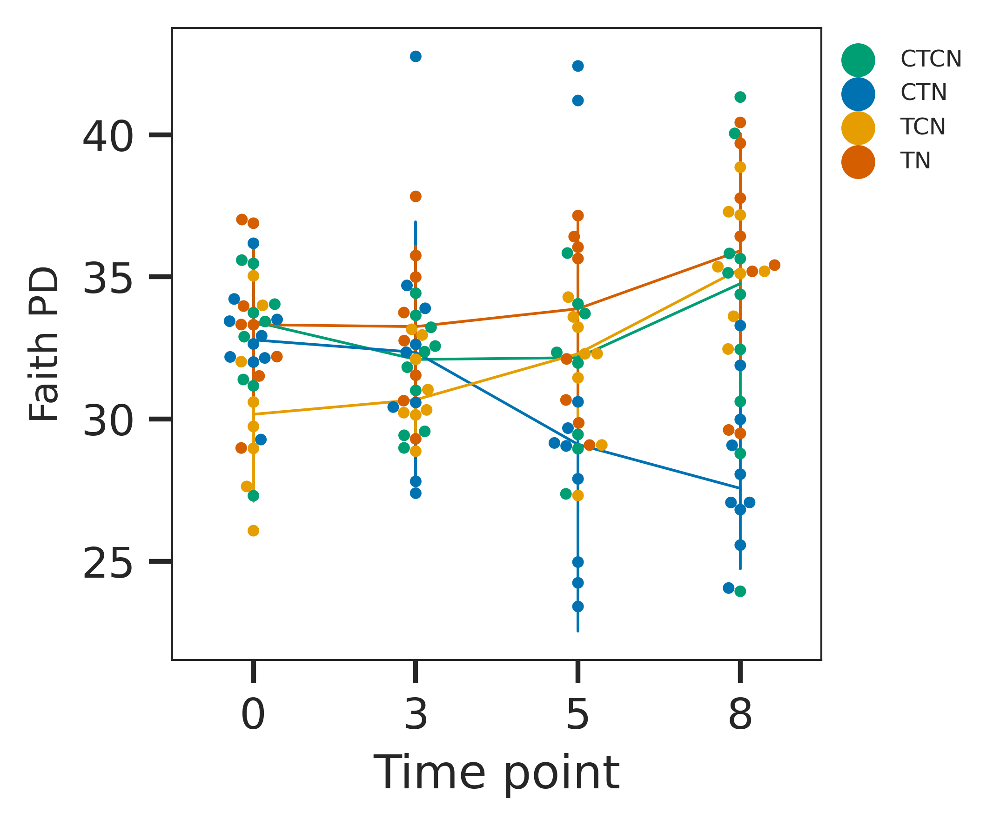

In [205]:
fig, ax = plt.subplots(dpi=600, figsize=(3,3))

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

#sns.boxplot(x='t',y='faith_pd',data=faithpd,order=[0,3,5,8], color='w',ax=ax)
sns.swarmplot(x='t',y='faith_pd',data=faithpd, hue='Treatment',ax=ax,palette=pal,size=3)
sns.lineplot(x='t',y='faith_pd',data=faithpd,hue='Treatment',ax=ax,palette=pal,ci='sd',err_style='bars',legend=False,estimator="median")
ax.legend(loc=1,bbox_to_anchor=(1.25,1),fontsize=6,frameon=False)
ax.set_ylabel('Faith PD',fontdict={'fontsize': 10})
ax.set_xlabel('Time point')
ax.set_xticklabels(['0','3','5','8'])
fig.savefig('Fig2.png',bbox_inches='tight')

In [80]:
qza = 'DIVERSITY_epiphytes/faith_pd_vector.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/alpha-diversity.tsv'
faithpd = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

measurements = pd.read_csv('nutrient_measurments.csv')

for ind, row in faithpd.iterrows():
    if not ind.startswith('AS'):
        continue
    treatment = metadata.loc[ind,'Treatment']
    tp = 'T%i' % metadata.loc[ind,'TP']
    temp = metadata.loc[ind,'Temp']
    temp_class = 'lo'
    if temp == 31:
        temp_class = 'hi'
    m = measurements.loc[((measurements.Treatment==treatment)&(measurements.TimePoint==tp))]
    for i,r in m.iterrows():
        faithpd.at[ind,r['Nutrient']] = r['MeanMeasuremnet']
    faithpd.at[ind,'Temp'] = temp
    faithpd.at[ind,'TempClass'] = temp_class
    
    
#faithpd = faithpd.dropna()
faithpd.index.name = 'sample id'
faithpd.to_csv('nutrients/faith_pd_without_water_effect.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file nutrients/faith_pd_without_water_effect.tsv \
    --p-formula "faith_pd ~ PO3 + NO2 + NH4 + NOX + DIN_IUI_ZMT + N_P + TempClass" \
    --o-visualization nutrients/faith_pd_without_water_effect.qzv

Saved Visualization to: nutrients/faith_pd_without_water_effect.qzv


In [177]:
for t in ['0tp','3tp','5tp','8tp']:
    
    depth=4000
    
    table = 'dada/table.%s.qza' % t
    outf = 'DIVERSITY_epiphytes/%s/' % t

    !qiime diversity core-metrics-phylogenetic \
      --i-phylogeny dada/rooted-tree.qza \
      --i-table $table \
      --p-sampling-depth $depth \
      --m-metadata-file metadata.tsv \
      --output-dir $outf
    
    for unifrac in ['weighted','unweighted']:
        
        matrix = outf + '%s_unifrac_distance_matrix.qza' % unifrac
        pcoa = outf + '%s_unifrac_pcoa_results.qza' % unifrac
        rare = outf + 'rarefied_table.qza'
        biplot = outf + '%s_unifrac_biplot_results.qza' % unifrac
    
        !qiime diversity pcoa \
          --i-distance-matrix $matrix \
          --p-number-of-dimensions 3 \
          --o-pcoa $pcoa

        !qiime feature-table relative-frequency \
          --i-table $rare \
          --o-relative-frequency-table temp.qza

        !qiime diversity pcoa-biplot \
          --i-pcoa $pcoa \
          --i-features temp.qza \
          --o-biplot $biplot

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/0tp/rarefied_table.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/faith_pd_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/observed_features_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/shannon_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/evenness_vector.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/unweighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/weighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/jaccard_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/bray_curtis_distance_matrix.qza
Saved PCoAResults to: DIVERSITY_epiphytes/0tp/unweighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/0tp/weighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/0tp/jaccard_pcoa_results.qza
Saved PCoAResults to: DIVE

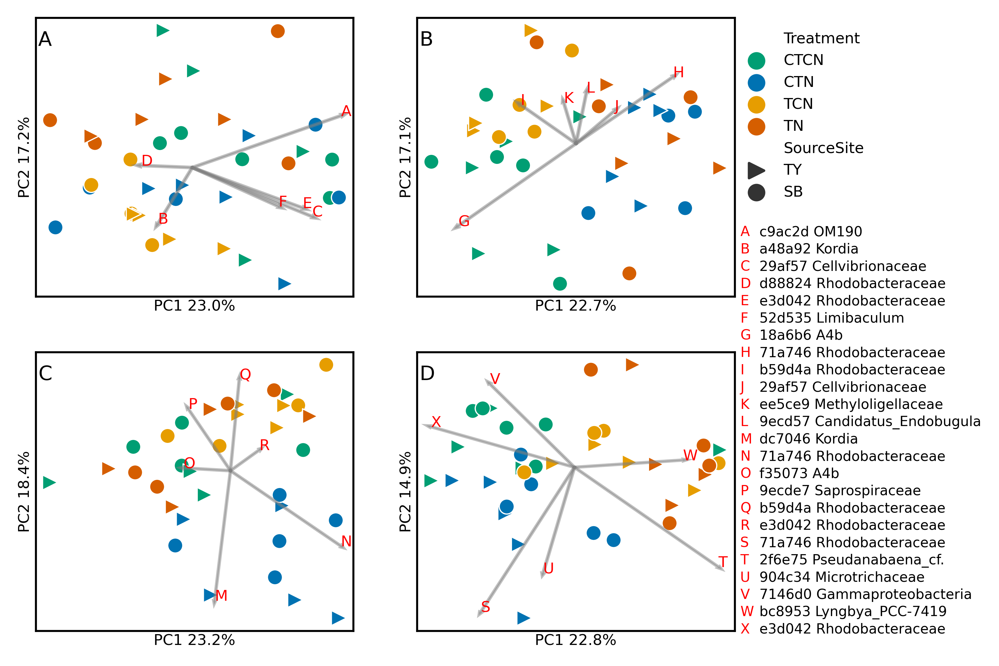

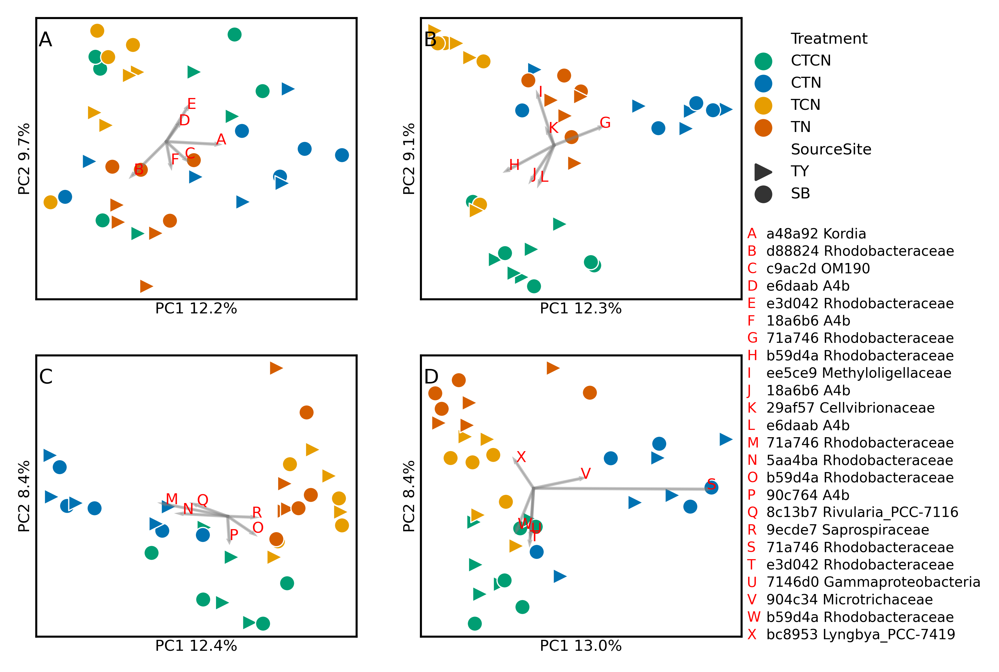

In [53]:
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
shape = {'SB':'o','TY':'>'}
taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

for unifrac in ['weighted','unweighted']:
    
    arrow_labels_legend = {}
    letter = 'a'
    ax_labels = ['A','B','C','D']
    
    tps = ['0tp','3tp','5tp','8tp']
    fig, axes = plt.subplots(nrows=2,ncols=2,dpi=600, figsize=(5,4.5))
    
    for row in axes:
        for ax in row:
            legend = False
            tp = tps.pop(0)
            if tp == '3tp':
                legend=True

            qza = 'DIVERSITY_epiphytes/%s/%s_unifrac_biplot_results.qza' % (tp,unifrac)
            ordination, biplot, Eigvals, Proportion = parse_biplot(qza)

            df = pd.concat([ordination,metadata.loc[ordination.index,:]],axis=1)
            df.columns = [str(i) for i in df.columns]
            
            sns.scatterplot(x='1',y='2',hue='Treatment',data=df,ax=ax, palette=pal,
                            style='SourceSite', markers=shape, legend=legend)
            if tp == '3tp':
                ax.legend(loc=1,bbox_to_anchor=(1.45,1),fontsize=6,frameon=False)
             
            ylim = ax.get_ylim()
            xlim = ax.get_xlim()

            arrow_data = get_arrow_coords(1,2,6,biplot)

            for arrow in arrow_data:
                arrow_x,text_x = arrow[1]*0.7,arrow[1]*0.7
                arrow_y, text_y = arrow[2]*0.7, arrow[2]*0.7
                
                if arrow_x < xlim[0] or arrow_x > xlim[1]:
                    arrow_x = arrow_x * 0.3
                    text_x = arrow_x
                
                if arrow_y < ylim[0] or arrow_y > ylim[1]:
                    arrow_y = arrow_y * 0.3
                    text_y = arrow_y

                ax.arrow(0, 0, arrow_x, arrow_y, fc='gray',ec='gray',alpha=0.5)

                asv = taxa.at[arrow[0],'Taxon']

                taxline = asv.split(';')
                tax = taxline.pop(-1)
                while 'Unknown' in tax or 'uncultured' in tax or tax == '__' in tax:
                    tax = taxline.pop(-1)
                tax = tax.split('__')[1]

                arrow_labels_legend[letter.upper()] = arrow[0][:6] + ' ' + tax
                ax.text(text_x, text_y, letter.upper(), fontdict={'fontsize': 6, 'color':'red'})
                letter = chr(ord(letter) + 1)
                
            ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=8)
            
            ax.tick_params(axis='both', length=0, pad=0)       
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xlabel('PC%i %.1f%%' % (1, Proportion[0]*100.0),fontdict={'fontsize': 6})
            ax.set_ylabel('PC%i %.1f%%' % (2, Proportion[1]*100.0),fontdict={'fontsize': 6})
            ax.xaxis.set_label_coords(0.5, -0.01)
            ax.yaxis.set_label_coords(-0.01, 0.5)
            ax.autoscale(enable=True, axis='both', tight=None)
            
            
    y = 1.5
    ax = axes[1][1]
    for i in arrow_labels_legend.items():
        ax.annotate(i[0],xy=(1.01,y),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=5.5,color='red')
        ax.annotate(i[1],xy=(1.07,y),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=5.5)
        y -= 0.062

    if unifrac == 'weighted':
        fig.savefig('FigS3.png', bbox_inches='tight')

    elif unifrac == 'unweighted':
        fig.savefig('Fig3.png', bbox_inches='tight')

In [ ]:
from ete3 import Tree, TextFace, CircleFace, NodeStyle, TreeStyle
from gzip import open as gopen
from Bio import Entrez, SeqIO
from time import sleep
from os import path
import glob
Entrez.email = "amir@adssc.org"

refs = SeqIO.to_dict(SeqIO.parse(gopen('SILVA_138.1_SSURef_NR99_tax_silva.fasta.gz','rt'),'fasta'))

for f in glob.glob('phylogenies/RAxML_bipartitions.*'):
    taxon = f.split('.')[-1]
    if path.exists('phylogenies/%s.png' % taxon):
        continue
    t = Tree(f)

    ns = NodeStyle()
    ns['size'] = 0

    t.set_outgroup(t.get_midpoint_outgroup())
    for n in t.traverse():
        n.set_style(ns)
        if n.is_leaf():
            if n.name in refs:
                color = 'black'
                desc =   refs[n.name].description.split(';')[-1]
                if desc.startswith(taxon):
                    color='blue'
                n.add_face(TextFace(n.name + ' ',fgcolor='black'),0,position='branch-right')
                n.add_face(TextFace(desc,fgcolor=color),1,position='branch-right')
                handle = Entrez.efetch(db="nucleotide", id=n.name.split('.')[0], rettype="gb", retmode="text")
                sleep(1)
                r = SeqIO.read(handle,'gb')
                handle.close()
                if 'isolation_source' in r.features[0].qualifiers:
                    source = r.features[0].qualifiers['isolation_source'][0]
                    n.add_face(TextFace(' '+source,fgcolor='green'),2,position='branch-right')
            else:
                n.add_face(TextFace(taxon+' '+n.name[:6],fgcolor='red'),0,position='branch-right')
        elif n.support > 60:
            n.add_face(CircleFace(4,'black'),0,position='float')

    ts = TreeStyle()
    ts.show_leaf_name = False
    ts.scale=2000

    t.render('phylogenies/%s.png' % taxon, tree_style=ts,dpi=600,w=1500)            
    t.render('%%inline',tree_style=ts,dpi=600)

**SB-TY test**

In [9]:
def distance_matrix(qza):
    a = !unzip $qza
    digest = a[1].split('/')[0].replace('  inflating: ','')
    inf = digest + '/data/distance-matrix.tsv'
    matrix = pd.read_csv(inf,sep='\t',index_col=0)
    !rm -r $digest
    return matrix

narrow2  = pd.DataFrame(columns = ['metric','Treatment','TP','a','b','Site_a','Site_b','withinamong','distance'])
narrow2.index.name = 'sample_name'

metadata = pd.read_csv('metadata.tsv', index_col=0,sep='\t')
for metric in ['weighted','unweighted']:
    matrix = distance_matrix('DIVERSITY_epiphytes/%s_unifrac_distance_matrix.qza' % (metric))
    samples = metadata.index.tolist()
    samples = [i for i in samples if i in matrix.index.tolist()]
    for t in set(metadata['T']):
        for i in range(len(samples)):
            for j in range(i+1,len(samples)):
                a = samples[i]
                b = samples[j]
                Site_a = metadata.at[a,'SourceSite']
                Site_b = metadata.at[b,'SourceSite']
                Treatment_a = metadata.at[a,'Treatment']
                Treatment_b = metadata.at[b,'Treatment']
                TP_a = metadata.at[a,'T']
                TP_b = metadata.at[b,'T']
                if TP_a != TP_b or Treatment_a != Treatment_b or TP_a != t:
                    continue
                within = None
                if Site_a == Site_b:
                    within = 'within %s' % Site_a
                else:
                    within = 'among sites'
                distance = matrix.at[a,b]
                narrow2.loc[len(narrow2)] = [metric,Treatment_a,TP_a,a,b,Site_a,Site_b,within,distance]
            
narrow2.index.name = 'sample_name'
for metric in ['weighted','unweighted']:
    for t in set(metadata['T']):
        table = 'DIVERSITY_epiphytes/%s_%s_within_vs_among_sites.tsv' % (t,metric)
        qzv = table.replace('.tsv','.qzv')
        narrow2.loc[((narrow2.metric==metric)&(narrow2.TP==t))].to_csv(table,sep='\t')
        !qiime longitudinal anova \
            --m-metadata-file $table \
            --p-formula "distance ~ withinamong + Treatment" \
            --o-visualization $qzv

Saved Visualization to: DIVERSITY_epiphytes/8tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/0tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/5tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/3tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/8tp_unweighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/0tp_unweighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/5tp_unweighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/3tp_unweighted_within_vs_among_sites.qzv


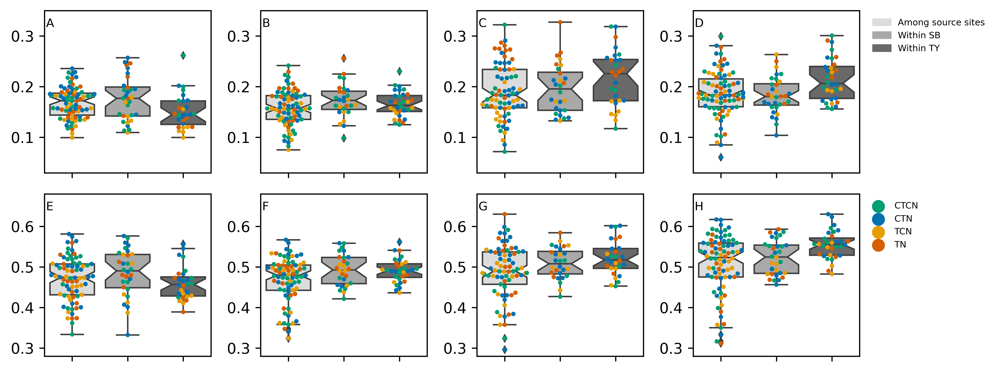

In [77]:
fig, axes = plt.subplots(nrows=2,ncols=4,tight_layout = True,dpi=600,figsize=(9.5,3.6))
metrics = ['weighted','unweighted']
letter = 'a'
among = mpatches.Patch(color='gainsboro', label='Among source sites')
SB = mpatches.Patch(color='darkgray', label='Within SB')
TY = mpatches.Patch(color='dimgray', label='Within TY')
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
for row in axes:
    metric = metrics.pop(0)
    tps = ['0tp','3tp','5tp','8tp']
    ylim = (0.03,0.35)
    if metric == 'unweighted':
        ylim=(0.28,0.68)
    for ax in row:
        tp = tps.pop(0)
        a = narrow2.loc[((narrow2.TP==tp)&(narrow2.metric==metric))]
        sns.boxplot(x='withinamong',y='distance',data=a,ax=ax,notch=True,palette=['gainsboro','darkgray','dimgray'],linewidth=1,fliersize=3)
        sns.swarmplot(x='withinamong',y='distance',data=a,ax=ax,hue='Treatment',palette=pal,size=3)
        ax.annotate(letter.upper(),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=8)
        ax.set_xlabel('')
        ax.set_ylabel('')
        letter = chr(ord(letter) + 1)
        red_patch = mpatches.Patch(color='red', label='The red data')
        blue_patch = mpatches.Patch(color='blue', label='The blue data')
        if letter == 'e':
            ax.legend(handles=[among, SB, TY],loc=1,bbox_to_anchor=(1.8,1),fontsize=6,frameon=False)
        elif letter != 'i':
            ax.legend().remove()
        else:
            ax.legend(loc=1,bbox_to_anchor=(1.4,1),fontsize=6,frameon=False)
        ax.set_xticklabels([])
        ax.set_ylim(ylim)
fig.savefig('Fig3a.png',bbox_inches='tight')

**Community maturity**

In [9]:
table = Artifact.load('dada/table.epiphyte.no_water.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',index_col=0,sep='\t')
metadata.index.name = 'sample-id'
metadata.loc[table.index.tolist(),:].to_csv('temp',sep='\t')
!mkdir maturity

p = 'Treatment'
v = 'CTCN'
alg = 'KNeighborsRegressor'
outf = 'maturity/%s_%s' % (alg,p)

!qiime longitudinal maturity-index \
    --i-table dada/table.epiphyte.qza \
    --m-metadata-file temp \
    --p-state-column TP \
    --p-group-by $p \
    --p-control $v \
    --p-estimator $alg \
    --p-n-jobs 7 \
    --p-test-size 0.5 \
    --p-n-estimators 150 \
    --p-parameter-tuning \
    --p-stratify \
    --p-random-state 4 \
    --output-dir $outf
!rm temp

mkdir: cannot create directory ‘maturity’: File exists
Saved SampleEstimator[Regressor] to: maturity/KNeighborsRegressor_Treatment/sample_estimator.qza
Saved FeatureData[Importance] to: maturity/KNeighborsRegressor_Treatment/feature_importance.qza
Saved SampleData[RegressorPredictions] to: maturity/KNeighborsRegressor_Treatment/predictions.qza
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/model_summary.qzv
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/accuracy_results.qzv
Saved SampleData[RegressorPredictions] to: maturity/KNeighborsRegressor_Treatment/maz_scores.qza
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/clustermap.qzv
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/volatility_plots.qzv


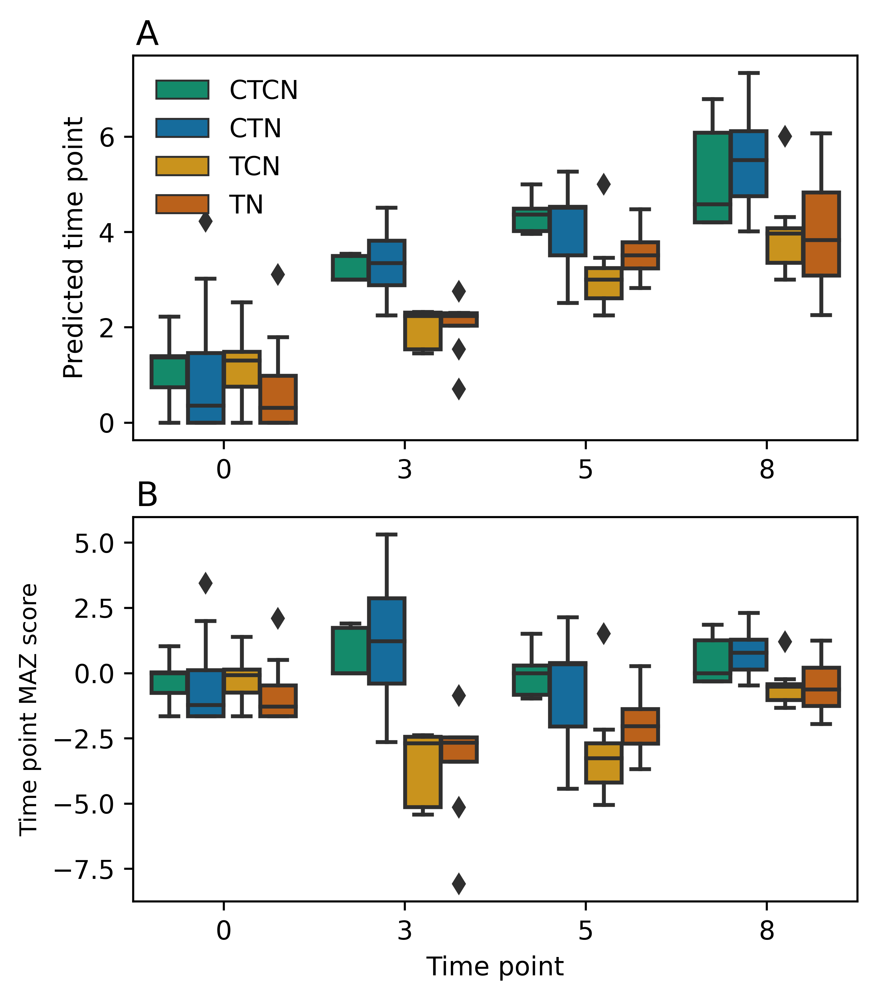

In [122]:
a = !unzip maturity/KNeighborsRegressor_Treatment/volatility_plots.qzv
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/data.tsv'
maz = pd.read_csv(inf,index_col=0,sep='\t',comment='#')
!rm -r $digest

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
metadata = pd.read_csv('metadata.tsv',index_col=0,sep='\t')

def get_tp(string):
    return metadata.at[string,'TP']

def get_bath(string):
    return metadata.at[string,'BathName']


fig, axes = plt.subplots(nrows=2, figsize=(5,6),dpi=600)
ax = axes[0]
sns.boxplot(x='TP',y='prediction',hue='Treatment', data=maz,ax=ax,palette=pal)
ax.legend(frameon=False).set_title('')
ax.set_xlabel('')
ax.set_ylabel('Predicted time point',fontdict={'size':10})
ax.annotate('A',xy=(0,1.13),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
ax = axes[1]
sns.boxplot(x='TP',y='TP MAZ score',hue='Treatment', data=maz,ax=ax,palette=pal)
ax.legend().set_visible(False)
ax.set_xlabel('Time point')
ax.set_ylabel('Time point MAZ score',fontdict={'size':9})
ax.annotate('B',xy=(0,1.13),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

fig.savefig('Fig4.png')

Model accuracy

<pre>
Mean squared error	r-value	r-squared	P-value	Std Error	Slope	Intercept
TP	2.911173	0.890163	0.79239	1.474067e-07	0.061261	0.50777	1.442134
</pre>

In [ ]:
PCOA taxa dynamics

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/rarefied_table.l5.qza


/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/i

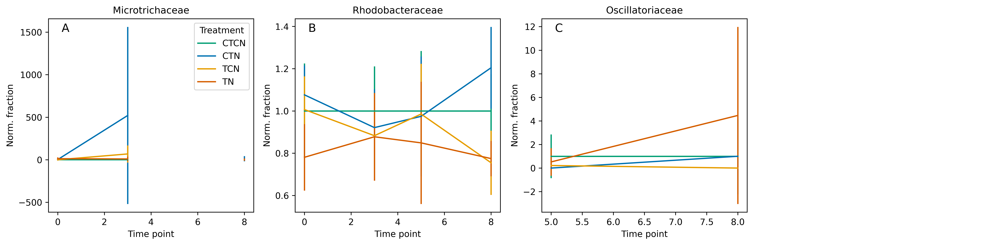

In [88]:
import math

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col = 0)
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

baseline_samples = metadata.loc[((metadata.TP==0) & (metadata.Fraction=='epiphyte'))].index.tolist()

!qiime taxa collapse \
  --i-table DIVERSITY_epiphytes/rarefied_table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 5 \
  --o-collapsed-table DIVERSITY_epiphytes/rarefied_table.l5.qza

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l5.qza').view(pd.DataFrame)
baseline_samples = [i for i in baseline_samples if i in table.index]
T0_table = table.loc[baseline_samples,:]

xx = [
 'Pseudanabaenaceae',
 'Oscillatoriaceae',
 'Rhodobacteraceae',
 'Microtrichaceae',
 'Anaerolineaceae']

core_ASVs_T0 = []
for n in xx:
    for i in table.columns:
        if n in i:
            core_ASVs_T0.append(i)
            break

narrow = pd.DataFrame(columns=['ASV','Sample','Treatment','TimePoint','CorrectRelativeAbundance'])
#R2_results = 

for asv in core_ASVs_T0:
    for smpl in table.index.tolist():
        
            time_point_samples = metadata.loc[((metadata.TP==metadata.at[smpl,'TP'])&(metadata.Treatment=='CTCN'))].index.tolist()
            time_point_samples = [i for i in time_point_samples if i in table.index]
            value = (table.at[smpl,asv]/table.loc[time_point_samples,[asv]].squeeze().mean())
            narrow.loc[len(narrow)] = [asv,smpl,metadata.at[smpl,'Treatment'],metadata.at[smpl,'TP'],value]
    

fig, axes = plt.subplots(nrows=math.ceil(len(core_ASVs_T0)/4),ncols=4, figsize=(16,math.ceil(len(core_ASVs_T0)/4)*4), dpi=600,tight_layout=True)

legend=True
letter = 'a'

core_ASVs_T0_keep = core_ASVs_T0.copy()

for row in axes:
    for ax in [row]:
        if len(core_ASVs_T0) == 0:
            ax.spines['top'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.set_xticklabels([])
            ax.set_xticks([])
            ax.set_yticklabels([])
            ax.set_yticks([])
            ax.set_ylabel('')
            ax.set_xlabel('')
            continue
        asv = core_ASVs_T0.pop()
        sns.lineplot(x='TimePoint',y='CorrectRelativeAbundance',
                     ci='sd',data=narrow.loc[narrow.ASV==asv],err_style='bars',
                     ax=ax,hue='Treatment',palette=pal,legend=legend)
        taxline = asv.split(';')
        tax = taxline.pop(-1)
        while 'Unknown' in tax or 'uncultured' in tax or tax == '__' or 'bacterium' in tax:
            tax = taxline.pop(-1)
            
        tax = tax.split('__')[-1].replace('_',' ')
            
        ax.set_ylabel('Norm. fraction',fontdict={'size':10})
        ax.set_xlabel('Time point',fontdict={'size':10})
        ax.set_title(tax,fontdict={'size':11})
        ax.annotate(letter.upper(),xy=(0.06,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        #info = "R\u00b2: %.2f" % results.at[asv,'R2']
        #max_gene = results.loc[asv,['NH4','NOX','DIN_IUI_ZMT','PO3','NO2']].squeeze().idxmax() 
        #if max_gene == 'NH4':
        #    max_gene = '$NH{_4}$'
        #elif max_gene == 'PO3':
        #    max_gene = '$PO{_3}$'
        #elif max_gene == 'NO2':
        #    max_gene = '$NO{_2}$'
        #ax.annotate(info,xy=(0.06,0.94),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        #ax.annotate(max_gene,xy=(0.06,0.89),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        legend=False
        letter = chr(ord(letter) + 1)
fig.savefig('Fig5_pcoa_family.png',bbox_inches='tight')

**Core taxa dynamics**

In [23]:
import math

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col = 0)
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

baseline_samples = metadata.loc[((metadata.TP==0) & (metadata.Fraction=='epiphyte'))].index.tolist()

!qiime taxa collapse \
  --i-table DIVERSITY_epiphytes/rarefied_table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 6 \
  --o-collapsed-table DIVERSITY_epiphytes/rarefied_table.l6.qza

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l6.qza').view(pd.DataFrame)
baseline_samples = [i for i in baseline_samples if i in table.index]
T0_table = table.loc[baseline_samples,:]

core_ASVs_T0 = []

for col in T0_table:
    if col.endswith(';__'):
        continue
    have_asv = [i>0 for i in T0_table[col]].count(True)
    if have_asv >= len(baseline_samples):
        core_ASVs_T0.append(col)

narrow = pd.DataFrame(columns=['ASV','Sample','Treatment','TimePoint','CorrectRelativeAbundance'])
#R2_results = 

for asv in core_ASVs_T0:
    for smpl in table.index.tolist():
        time_point_samples = metadata.loc[((metadata.TP==metadata.at[smpl,'TP'])&(metadata.Treatment=='CTCN'))].index.tolist()
        time_point_samples = [i for i in time_point_samples if i in table.index]
        value = (table.at[smpl,asv]/table.loc[time_point_samples,[asv]].squeeze().mean())
        narrow.loc[len(narrow)] = [asv,smpl,metadata.at[smpl,'Treatment'],metadata.at[smpl,'TP'],value]
    

fig, axes = plt.subplots(nrows=math.ceil(len(core_ASVs_T0)/4),ncols=4, figsize=(16,math.ceil(len(core_ASVs_T0)/4)*4), dpi=600,tight_layout=True)

legend=True
letter = 'a'

core_ASVs_T0_keep = core_ASVs_T0.copy()

for row in axes:
    for ax in row:
        if len(core_ASVs_T0) == 0:
            ax.spines['top'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.set_xticklabels([])
            ax.set_xticks([])
            ax.set_yticklabels([])
            ax.set_yticks([])
            ax.set_ylabel('')
            ax.set_xlabel('')
            continue
        asv = core_ASVs_T0.pop()
        sns.lineplot(x='TimePoint',y='CorrectRelativeAbundance',
                     ci='sd',data=narrow.loc[narrow.ASV==asv],err_style='bars',
                     ax=ax,hue='Treatment',palette=pal,legend=legend)
        taxline = asv.split(';')
        tax = taxline.pop(-1)
        while 'Unknown' in tax or 'uncultured' in tax or tax == '__' or 'bacterium' in tax:
            tax = taxline.pop(-1)
            
        tax = tax.split('__')[-1].replace('_',' ')
            
        ax.set_ylabel('Norm. fraction',fontdict={'size':10})
        ax.set_xlabel('Time point',fontdict={'size':10})
        ax.set_title(tax,fontdict={'size':11})
        ax.annotate(letter.upper(),xy=(0.06,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        info = "R\u00b2: %.2f" % results.at[asv,'R2']
        max_gene = results.loc[asv,['NH4','NOX','DIN_IUI_ZMT','PO3','NO2']].squeeze().idxmax() 
        if max_gene == 'NH4':
            max_gene = '$NH{_4}$'
        elif max_gene == 'PO3':
            max_gene = '$PO{_3}$'
        elif max_gene == 'NO2':
            max_gene = '$NO{_2}$'
        ax.annotate(info,xy=(0.06,0.94),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        ax.annotate(max_gene,xy=(0.06,0.89),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        legend=False
        letter = chr(ord(letter) + 1)
fig.savefig('Fig5_genus.png',bbox_inches='tight')

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/rarefied_table.l6.qza


In [6]:
core_ASVs_T0_keep

['d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Chitinophagales;f__Saprospiraceae;g__Lewinella',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Chitinophagales;f__Saprospiraceae;g__Portibacter',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Chitinophagales;f__Saprospiraceae;g__uncultured',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Chitinophagales;f__uncultured;g__uncultured',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Cytophagales;f__Cyclobacteriaceae;g__Ekhidna',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Cytophagales;f__Cyclobacteriaceae;g__Marinoscillum',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Flavobacteriales;f__Cryomorphaceae;g__Cryomorpha',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Flavobacteriales;f__Flavobacteriaceae;g__Flavobacteriaceae',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Flavobacteriales;f__Flavobacteriaceae;g__Muricauda',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Flavobacteriales;f__Flavobacteriaceae;g__Winogradskyella',


/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/i

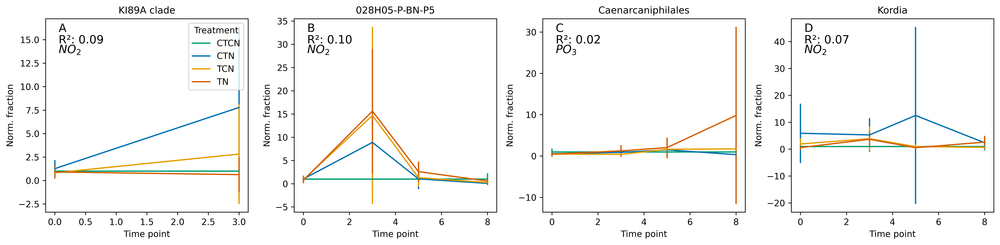

In [20]:
import math

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col = 0)
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)

baseline_samples = metadata.loc[((metadata.TP==0) & (metadata.Fraction=='epiphyte')& (metadata.SourceSite=='SB'))].index.tolist()

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l6.qza').view(pd.DataFrame)
baseline_samples = [i for i in baseline_samples if i in table.index]
T0_table = table.loc[baseline_samples,:]

core_ASVs_T0 = []

for col in T0_table:
    if col.endswith(';__'):
        continue
    have_asv = [i>0 for i in T0_table[col]].count(True)
    if have_asv >= len(baseline_samples):
        core_ASVs_T0.append(col)

narrow = pd.DataFrame(columns=['ASV','Sample','Treatment','TimePoint','CorrectRelativeAbundance'])

for asv in core_ASVs_T0:
    for smpl in table.index.tolist():
        time_point_samples = metadata.loc[((metadata.TP==metadata.at[smpl,'TP'])&(metadata.Treatment=='CTCN'))].index.tolist()
        time_point_samples = [i for i in time_point_samples if i in table.index]
        value = table.at[smpl,asv]/table.loc[time_point_samples,[asv]].squeeze().mean()
        narrow.loc[len(narrow)] = [asv,smpl,metadata.at[smpl,'Treatment'],metadata.at[smpl,'TP'],value]
    
core_ASVs_T0 = [i for i in core_ASVs_T0 if i not in core_ASVs_T0_keep]
fig, axes = plt.subplots(nrows=math.ceil(len(core_ASVs_T0)/4),ncols=4, figsize=(16,math.ceil(len(core_ASVs_T0)/4)*4), dpi=600,tight_layout=True)

legend=True
letter = 'a'


core_ASVs_T0_keep_unique_SB = core_ASVs_T0.copy()
for ax in axes:
    for a in ['row']:
        if len(core_ASVs_T0) == 0:
            ax.spines['top'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.set_xticklabels([])
            ax.set_xticks([])
            ax.set_yticklabels([])
            ax.set_yticks([])
            ax.set_ylabel('')
            ax.set_xlabel('')
            continue
        asv = core_ASVs_T0.pop()
        sns.lineplot(x='TimePoint',y='CorrectRelativeAbundance',
                     ci='sd',data=narrow.loc[narrow.ASV==asv],err_style='bars',
                     ax=ax,hue='Treatment',palette=pal,legend=legend)
        taxline = asv.split(';')
        tax = taxline.pop(-1)
        while 'Unknown' in tax or 'uncultured' in tax or tax == '__' or 'bacterium' in tax:
            tax = taxline.pop(-1)
            
        tax = tax.split('__')[-1].replace('_',' ')
            
        ax.set_ylabel('Norm. fraction',fontdict={'size':10})
        ax.set_xlabel('Time point',fontdict={'size':10})
        ax.set_title(tax,fontdict={'size':11})
        ax.annotate(letter.upper(),xy=(0.06,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        info = "R\u00b2: %.2f" % results.at[asv,'R2']
        max_gene = results.loc[asv,['NH4','NOX','DIN_IUI_ZMT','PO3','NO2']].squeeze().idxmax() 
        if max_gene == 'NH4':
            max_gene = '$NH{_4}$'
        elif max_gene == 'PO3':
            max_gene = '$PO{_3}$'
        elif max_gene == 'NO2':
            max_gene = '$NO{_2}$'
        ax.annotate(info,xy=(0.06,0.94),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        ax.annotate(max_gene,xy=(0.06,0.89),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        legend=False
        letter = chr(ord(letter) + 1)
fig.savefig('FigS4_genus.png',bbox_inches='tight')

In [11]:
core_ASVs_T0_keep_unique_SB

['d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Flavobacteriales;f__Flavobacteriaceae;g__Kordia',
 'd__Bacteria;p__Cyanobacteria;c__Vampirivibrionia;o__Caenarcaniphilales;f__Caenarcaniphilales;g__Caenarcaniphilales',
 'd__Bacteria;p__Planctomycetota;c__028H05-P-BN-P5;o__028H05-P-BN-P5;f__028H05-P-BN-P5;g__028H05-P-BN-P5',
 'd__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__KI89A_clade;f__KI89A_clade;g__KI89A_clade']

In [21]:
import math

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col = 0)
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)

baseline_samples = metadata.loc[((metadata.TP==0) & (metadata.Fraction=='epiphyte')& (metadata.SourceSite=='TY'))].index.tolist()

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l6.qza').view(pd.DataFrame)
baseline_samples = [i for i in baseline_samples if i in table.index]
T0_table = table.loc[baseline_samples,:]

core_ASVs_T0 = []

for col in T0_table:
    if col.endswith(';__'):
        continue
    have_asv = [i>0 for i in T0_table[col]].count(True)
    if have_asv >= len(baseline_samples):
        core_ASVs_T0.append(col)
        
core_ASVs_T0 = [i for i in core_ASVs_T0 if i not in core_ASVs_T0_keep]
narrow = pd.DataFrame(columns=['ASV','Sample','Treatment','TimePoint','CorrectRelativeAbundance'])

for asv in core_ASVs_T0:
    for smpl in table.index.tolist():
        time_point_samples = metadata.loc[((metadata.TP==metadata.at[smpl,'TP'])&(metadata.Treatment=='CTCN'))].index.tolist()
        time_point_samples = [i for i in time_point_samples if i in table.index]
        value = table.at[smpl,asv]/table.loc[time_point_samples,[asv]].squeeze().mean()
        narrow.loc[len(narrow)] = [asv,smpl,metadata.at[smpl,'Treatment'],metadata.at[smpl,'TP'],value]
    

fig, axes = plt.subplots(nrows=math.ceil(len(core_ASVs_T0)/4),ncols=4, figsize=(16,math.ceil(len(core_ASVs_T0)/4)*4), dpi=600,tight_layout=True)

legend=True
letter = 'a'

core_ASVs_T0_keep_unique_TY = core_ASVs_T0.copy()

for row in axes:
    for ax in row:
        if len(core_ASVs_T0) == 0:
            ax.spines['top'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.set_xticklabels([])
            ax.set_xticks([])
            ax.set_yticklabels([])
            ax.set_yticks([])
            ax.set_ylabel('')
            ax.set_xlabel('')
            continue
        asv = core_ASVs_T0.pop()
        sns.lineplot(x='TimePoint',y='CorrectRelativeAbundance',
                     ci='sd',data=narrow.loc[narrow.ASV==asv],err_style='bars',
                     ax=ax,hue='Treatment',palette=pal,legend=legend)
        taxline = asv.split(';')
        tax = taxline.pop(-1)
        while 'Unknown' in tax or 'uncultured' in tax or tax == '__' or 'bacterium' in tax:
            tax = taxline.pop(-1)
            
        tax = tax.split('__')[-1].replace('_',' ')
            
        ax.set_ylabel('Norm. fraction',fontdict={'size':10})
        ax.set_xlabel('Time point',fontdict={'size':10})
        ax.set_title(tax,fontdict={'size':11})
        ax.annotate(letter.upper(),xy=(0.06,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        info = "R\u00b2: %.2f" % results.at[asv,'R2']
        max_gene = results.loc[asv,['NH4','NOX','DIN_IUI_ZMT','PO3','NO2']].squeeze().idxmax() 
        if max_gene == 'NH4':
            max_gene = '$NH{_4}$'
        elif max_gene == 'PO3':
            max_gene = '$PO{_3}$'
        elif max_gene == 'NO2':
            max_gene = '$NO{_2}$'
        ax.annotate(info,xy=(0.06,0.94),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        ax.annotate(max_gene,xy=(0.06,0.89),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        legend=False
        letter = chr(ord(letter) + 1)
fig.savefig('FigS5_genus.png',bbox_inches='tight')

In [15]:
core_ASVs_T0_keep_unique_TY

['d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Cytophagales;f__Cyclobacteriaceae;g__uncultured',
 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Flavobacteriales;f__Flavobacteriaceae;g__Aureisphaera',
 'd__Bacteria;p__Bdellovibrionota;c__Bdellovibrionia;o__Bdellovibrionales;f__Bdellovibrionaceae;g__Bdellovibrio',
 'd__Bacteria;p__Myxococcota;c__Myxococcia;o__Myxococcales;f__Myxococcaceae;g__P3OB-42',
 'd__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Caulobacterales;f__Hyphomonadaceae;g__uncultured',
 'd__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Rhodobacterales;f__Rhodobacteraceae;g__Roseobacter_clade_CHAB-I-5_lineage',
 'd__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Rhodobacterales;f__Rhodobacteraceae;g__Rubrimonas',
 'd__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Sphingomonadales;f__Sphingomonadaceae;g__Altererythrobacter',
 'd__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__uncultured;f__uncultured;g__uncultured',
 'd__Bacteria;p__Proteo

In [16]:
df = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l6.qza').view(pd.DataFrame)

df = df.loc[:,core_ASVs_T0_keep+core_ASVs_T0_keep_unique_SB+core_ASVs_T0_keep_unique_TY]

letter = 'a'

letter_to_asv = {}
columns = []

start = 'a'
for i in df.columns:
    letter_to_asv[start.upper()+letter.upper()] = i
    columns.append(start.upper()+letter.upper())
    if letter == 'z':
        letter = 'a'
        start = 'b'
    else:
        letter = chr(ord(letter) + 1)
    
df.columns = columns

metadata = pd.read_csv('nutrients/faith_pd_without_water_effect.tsv',sep='\t',index_col=0)

df = pd.concat([df,metadata],axis=1)

import statsmodels.formula.api as sm

results = pd.DataFrame(columns=['R2','NH4','NOX','DIN_IUI_ZMT','PO3','NO2'])

for asv in columns:
    result = sm.ols(formula="%s ~ NH4 + NOX + DIN_IUI_ZMT + PO3 + NO2" % asv, data=df).fit()
    r2 = result.rsquared
    series=[r2]
    result = sm.ols(formula="%s ~ NOX + DIN_IUI_ZMT + PO3 + NO2" % asv, data=df).fit()
    series += [r2-result.rsquared]
    result = sm.ols(formula="%s ~ NH4 + DIN_IUI_ZMT + PO3 + NO2" % asv, data=df).fit()
    series += [r2-result.rsquared]
    result = sm.ols(formula="%s ~ NH4 + NOX  + PO3 + NO2" % asv, data=df).fit()
    series += [r2-result.rsquared]
    result = sm.ols(formula="%s ~ NH4 + NOX + DIN_IUI_ZMT + NO2" % asv, data=df).fit()
    series += [r2-result.rsquared]
    result = sm.ols(formula="%s ~ NH4 + NOX + DIN_IUI_ZMT + PO3" % asv, data=df).fit()
    series += [r2-result.rsquared]
    results.loc[letter_to_asv[asv]]=series

In [18]:
results.to_csv('TableS1_genus.tsv',sep='\t')

In [162]:
table = Artifact.load('dada/table.epiphyte.no_water.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',index_col=0,sep='\t')
metadata.index.name = 'sample-id'
def nut(string):
    if string in 'BD':
        return 'nutrients'
    return 'no_nutrients'
def tem(string):
    if string in 'CD':
        return 'temp'
    return 'no_temp'
metadata['Nutrient_stress'] = metadata.BathName.apply(nut)
metadata['Temp_stress'] = metadata.BathName.apply(tem)
metadata = metadata.loc[table.index.tolist(),:]
table = table.div(table.sum(axis=1), axis=0)

In [168]:
# kruskal walis

kw_results = pd.DataFrame(columns = ['bacterium','mean','factor','tp','metric','p'])

for tp in [0,3,5,8]:
    for factor in ['BathName','Nutrient_stress','Temp_stress']:
        for asv in table.columns:
            samples = []
            for group in set(metadata[factor]):
                samples.append(metadata.loc[metadata[factor] == group].index.tolist())
            data = []
            for group in samples:
                data.append(table.loc[group,asv].dropna().squeeze().tolist())
            mean = []
            for i in data:
                mean += i
            mean = np.average(mean)
            kw_results.loc[len(kw_results)] = [asv,mean,factor,tp] + list(kruskal(*data))
            

kw_results['q'] = multipletests(kw_results.p,method='fdr_bh')[1]

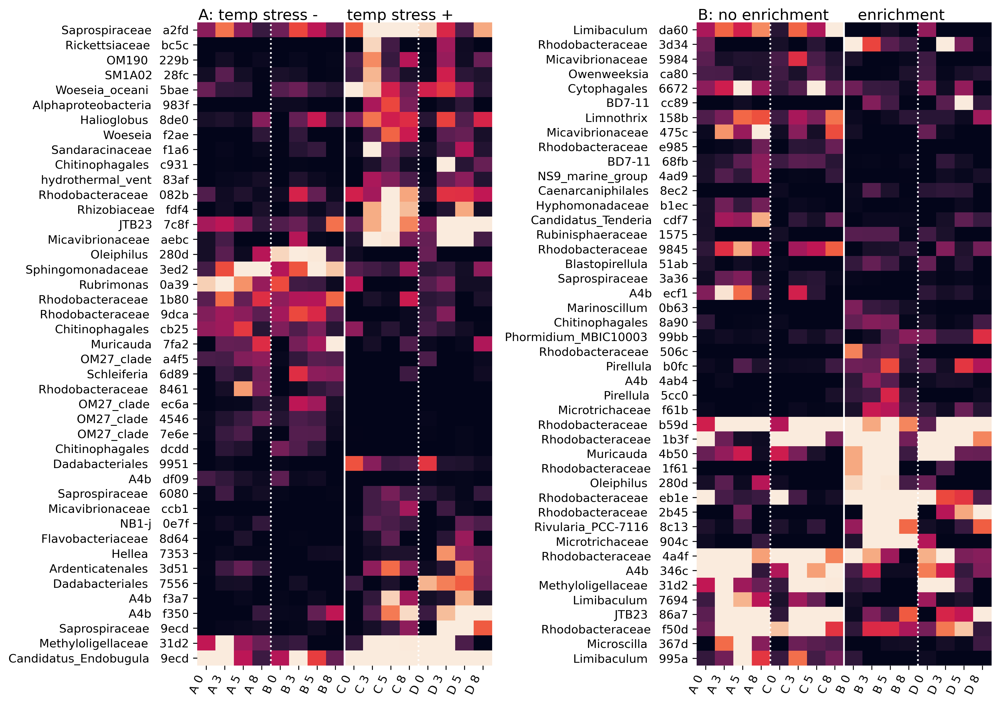

In [189]:
fig, axes = plt.subplots(ncols=2, figsize=(12,8.5),dpi=300,tight_layout=True)
ax = axes[0]
w_asvs = Artifact.load('dada/table.water.qza').view(pd.DataFrame).columns.tolist()
mean_table = {}

qza = 'dada/taxonomy.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/taxonomy.tsv'
taxa = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

log = open('sig_taxa.txt','wt')

for bact in set(kw_results.loc[((kw_results.q < 0.0007)&(kw_results.factor == 'Temp_stress'))].sort_values('mean')['bacterium']):
    if bact in w_asvs:
        continue
    taxonomy = taxa.at[bact,'Taxon'].split(';')
    log.write('Temp_stress\t%s' % taxa.at[bact,'Taxon'])
    asv = taxonomy.pop(-1)
    while 'ncultured' in asv or 'metagenome' in asv or 'nidentified' in asv:
        asv = taxonomy.pop(-1)
    asv = asv.split('__')[-1] +'   '+ bact[:4]
    for bath in 'ABCD':
        for tp in [0,3,5,8]:
            samples = metadata.loc[((metadata.TP==tp)&(metadata.BathName==bath))].index.tolist()
            if '%s %i' % (bath,tp) not in mean_table:
                mean_table['%s %i' % (bath,tp)] = {}
            mean_table['%s %i' % (bath,tp)][asv] = table.loc[samples,[bact]][bact].mean()
            
df = pd.DataFrame(mean_table)

df['bb'] = df.max(axis=1)
df = df.loc[df.bb>0.0008]
df = df.drop('bb',axis=1)


from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

pca = PCA(n_components=2)
pca.fit_transform(df.transpose())
clustering = KMeans(n_clusters=3).fit([[i] for i in pca.components_[1]])

df['aa'] = clustering.labels_
df['bb'] = pca.components_[0]

for i in df.index:
    for col in df.columns:
        if df.at[i,col] == df.max(axis=1)[i]:
            df.at[i,'max_col'] = col
            continue
df = df.sort_values(['aa','bb'])
df = df.drop('aa',axis=1)
df = df.drop('bb',axis=1)
df = df.drop('max_col',axis=1)
        
sns.heatmap(df,vmax=0.004,ax=ax,cbar=False,yticklabels=True)
ax.set_xticklabels(ax.get_xticklabels(),rotation=65, horizontalalignment='right')
ax.vlines([8], *ax.get_ylim(),colors=['white'])
ax.vlines([4,12], *ax.get_ylim(),colors=['white']*2,linestyles=['dotted']*2)

ax.annotate('A: temp stress -      temp stress +',
            xy=(0,1),
            xycoords="axes fraction",
            xytext=(1,12),
            textcoords="offset points",
            ha="left",va="top",size=13)

ax = axes[1]
mean_table = {}

for bact in set(kw_results.loc[((kw_results.q < 0.0007)&(kw_results.factor == 'Nutrient_stress'))]['bacterium']):
    if bact in w_asvs:
        continue
    taxonomy = taxa.at[bact,'Taxon'].split(';')
    log.write('Temp_stress\t%s' % taxa.at[bact,'Taxon'])
    asv = taxonomy.pop(-1)
    while 'ncultured' in asv or 'metagenome' in asv or 'nidentified' in asv:
        asv = taxonomy.pop(-1)
    asv = asv.split('__')[-1] +'   '+ bact[:4]
    for bath in 'ACBD':
        for tp in [0,3,5,8]:
            samples = metadata.loc[((metadata.TP==tp)&(metadata.BathName==bath))].index.tolist()
            if '%s %i' % (bath,tp) not in mean_table:
                mean_table['%s %i' % (bath,tp)] = {}
            mean_table['%s %i' % (bath,tp)][asv] = table.loc[samples,[bact]][bact].mean()
            
df = pd.DataFrame(mean_table)

df['bb'] = df.max(axis=1)
df = df.loc[df.bb>0.0008]
df = df.drop('bb',axis=1)

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

pca = PCA(n_components=2)
pca.fit_transform(df.transpose())
clustering = KMeans(n_clusters=4).fit([[i] for i in pca.components_[0]])

df['aa'] = clustering.labels_
df['bb'] = pca.components_[1]

for i in df.index:
    for col in df.columns:
        if df.at[i,col] == df.max(axis=1)[i]:
            df.at[i,'max_col'] = col
            continue
df = df.sort_values(['aa','bb'])
df = df.drop('aa',axis=1)
df = df.drop('bb',axis=1)
df = df.drop('max_col',axis=1)
            
log.close()
sns.heatmap(df,vmax=0.004,ax=ax,cbar=False,yticklabels=True)
ax.set_xticklabels(ax.get_xticklabels(),rotation=65, horizontalalignment='right')
ax.vlines([8], *ax.get_ylim(),colors=['white'])
ax.vlines([4,12], *ax.get_ylim(),colors=['white']*2,linestyles=['dotted']*2)

ax.annotate('B: no enrichment      enrichment',
            xy=(0,1),
            xycoords="axes fraction",
            xytext=(1,12),
            textcoords="offset points",
            ha="left",va="top",size=13)

fig.savefig('Fig5.png',bbox_inches='tight')

In [30]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l6.qza').view(pd.DataFrame)

!mkdir asv_clusters

narrow = pd.DataFrame(columns=['T0','T3','T5','T8'])
for treatment in set(metadata.Treatment):
    for tank in set(metadata.loc[metadata.Treatment == treatment]['Tank']):  
        for site in ['SB','TY']:    
            for asv in table:
                if asv.endswith(';__'):
                    continue
                try:
                    t0_sample = metadata.loc[((metadata.Treatment == treatment)&(metadata.Tank == tank)&(metadata.TP == 0)&(metadata.SourceSite == site))].index.tolist()[0]
                    t3_sample = metadata.loc[((metadata.Treatment == treatment)&(metadata.Tank == tank)&(metadata.TP == 3)&(metadata.SourceSite == site))].index.tolist()[0]
                    t5_sample = metadata.loc[((metadata.Treatment == treatment)&(metadata.Tank == tank)&(metadata.TP == 5)&(metadata.SourceSite == site))].index.tolist()[0]
                    t8_sample = metadata.loc[((metadata.Treatment == treatment)&(metadata.Tank == tank)&(metadata.TP == 8)&(metadata.SourceSite == site))].index.tolist()[0]
                except:
                    continue
                try:
                    row = [table.at[t0_sample,asv]]
                    row += [table.at[t3_sample,asv]]
                    row += [table.at[t5_sample,asv]]
                    row += [table.at[t8_sample,asv]]
                except:
                    continue

                if not any([i>7 for i in row]):
                    continue
                core = "NotCore"
                if asv in core_ASVs_T0_keep_unique_SB:
                    core = 'SB'
                if asv in core_ASVs_T0_keep_unique_TY:
                    core = 'TY'
                if asv in core_ASVs_T0_keep:
                    core = 'Core'
                narrow.loc[';'.join(asv.split(';')[-3:])+'~~_%s_tank%i_%s_%s' % (treatment,tank,site,core)] = row

mkdir: cannot create directory ‘asv_clusters’: File exists


In [31]:
narrow

,T0,T3,T5,T8
o__Acanthopleuribacterales;f__Acanthopleuribacteraceae;g__Acanthopleuribacter~~_CTCN_tank1_SB_NotCore,8.0,1.0,1.0,0.0
o__Chitinophagales;f__Saprospiraceae;g__Lewinella~~_CTCN_tank1_SB_Core,54.0,7.0,90.0,28.0
o__Chitinophagales;f__Saprospiraceae;g__Phaeodactylibacter~~_CTCN_tank1_SB_NotCore,3.0,0.0,8.0,0.0
o__Chitinophagales;f__Saprospiraceae;g__Portibacter~~_CTCN_tank1_SB_Core,36.0,20.0,67.0,1.0
o__Chitinophagales;f__Saprospiraceae;g__uncultured~~_CTCN_tank1_SB_Core,29.0,16.0,112.0,32.0
...,...,...,...,...
o__Methylacidiphilales;f__Methylacidiphilaceae;g__uncultured~~_TN_tank20_TY_NotCore,0.0,2.0,3.0,20.0
o__Verrucomicrobiales;f__DEV007;g__DEV007~~_TN_tank20_TY_NotCore,24.0,30.0,27.0,5.0
o__Verrucomicrobiales;f__Rubritaleaceae;g__Persicirhabdus~~_TN_tank20_TY_NotCore,0.0,6.0,20.0,2.0
o__Verrucomicrobiales;f__Rubritaleaceae;g__Roseibacillus~~_TN_tank20_TY_NotCore,11.0,0.0,0.0,0.0


In [32]:

if 'label' in narrow.columns:
    narrow = narrow.drop('label',axis=1)
    
for ind, row in narrow.iterrows():
    minval = row.min()
    row = row - minval
    maxval = row.max()
    row = row/maxval
    narrow.loc[ind] = row

In [33]:
#scaler = StandardScaler()
#scaler.fit(narrow)
#data = scaler.transform(narrow)

clustering = KMeans(n_clusters=12).fit(narrow)

narrow['label'] = clustering.labels_

narrow.to_csv('asv_clusters/genus_dynamics_per_tank.tsv',sep='\t')
    

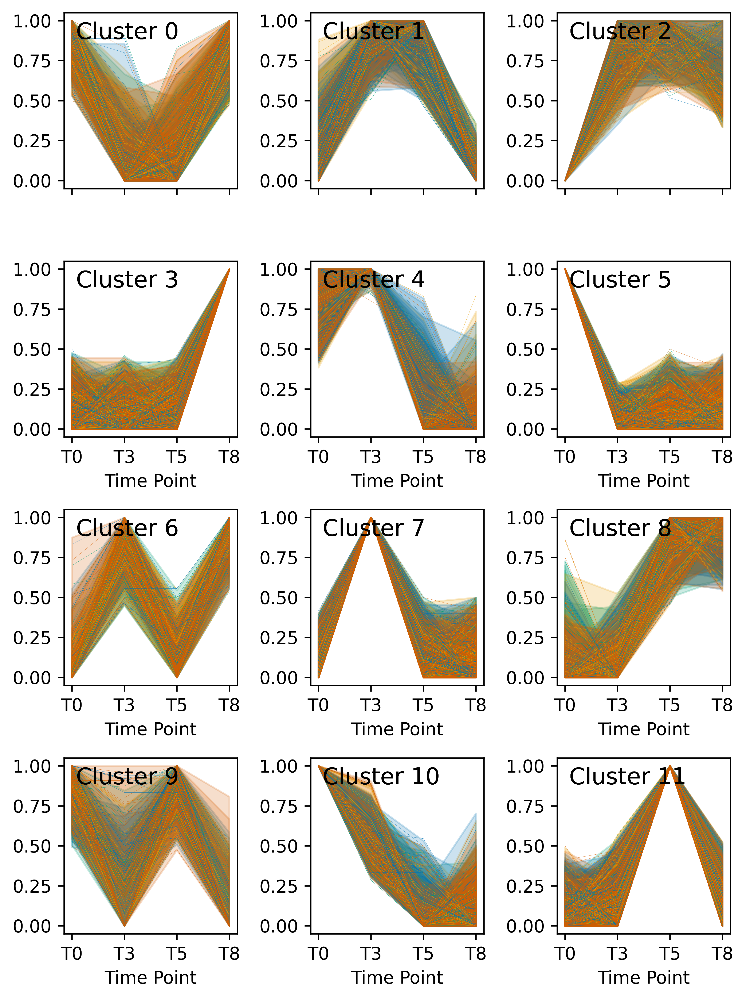

In [38]:
df = pd.read_csv('asv_clusters/genus_dynamics_per_tank.tsv',sep='\t',index_col=0)
narrow = pd.DataFrame(columns=['ASV','Treatment','Tank','Site','Time Point', 'Value','Cluster'])
for ind, row in df.iterrows():
    asv, other = ind.split('~~')
    xx,treatment,tank,site,core = other.split('_')
    for col in ['T0','T3','T5','T8']:
        narrow.loc[len(narrow)] = [asv,treatment,tank,site,col,df.at[ind, col],df.at[ind,'label']]

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
fig, axes = plt.subplots(nrows=4,ncols=3,dpi=600,tight_layout=True,figsize=(6,8))

for treatment in set(narrow.Treatment):    
    label = 0

    for row in axes:
        for ax in row:
            sns.lineplot(x='Time Point',y='Value',hue='ASV',data=narrow.loc[((narrow.Cluster==label)&(narrow.Treatment==treatment))],ax=ax,legend=False,
                         palette=[pal[treatment]]*len(set(narrow.loc[((narrow.Cluster==label)&(narrow.Treatment==treatment))]['ASV'])),
                         linewidth=0.1)
            if label < 3:
                ax.set_xticklabels([])
                ax.set_xlabel('')
            ax.set_ylabel('')
            ax.annotate('Cluster '+str(label),xy=(0.06,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            
            label += 1
fig.savefig('clusters_genera.png')

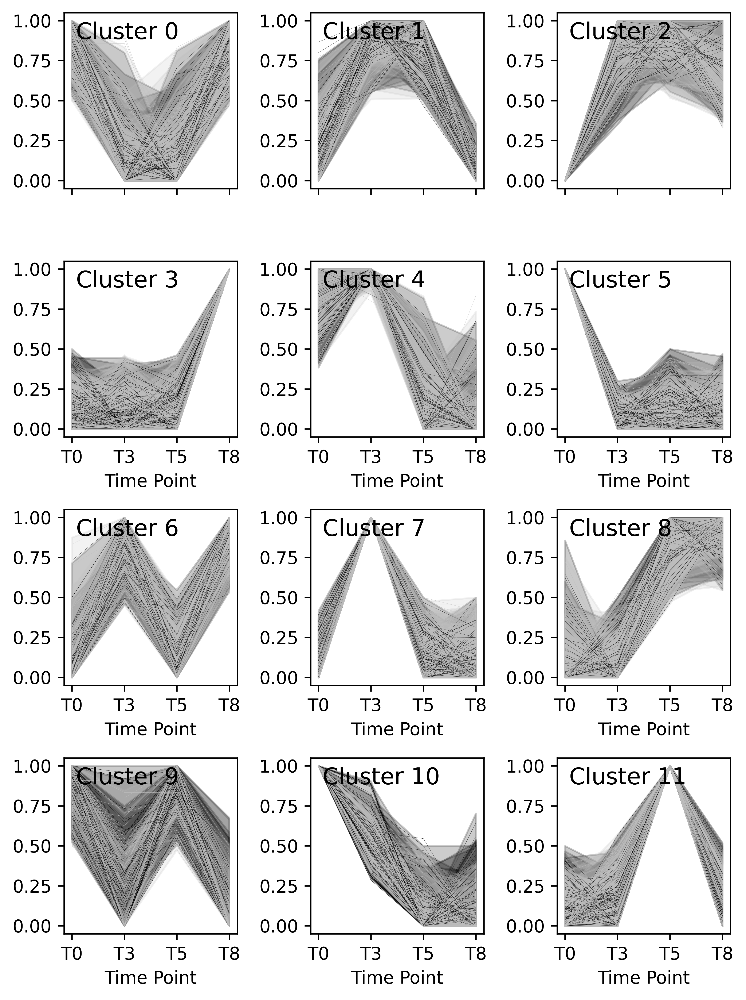

In [40]:
df = pd.read_csv('asv_clusters/genus_dynamics_per_tank.tsv',sep='\t',index_col=0)
narrow = pd.DataFrame(columns=['ASV','Treatment','Tank','Site','Time Point', 'Value','Cluster'])
for ind, row in df.iterrows():
    asv, other = ind.split('~~')
    xx,treatment,tank,site,core = other.split('_')
    for col in ['T0','T3','T5','T8']:
        narrow.loc[len(narrow)] = [asv,treatment,tank,site,col,df.at[ind, col],df.at[ind,'label']]

pal_site={'TY':'black','SB':'silver'}
fig, axes = plt.subplots(nrows=4,ncols=3,dpi=600,tight_layout=True,figsize=(6,8))

for site in set(narrow.Site):    
    label = 0

    for row in axes:
        for ax in row:
            sns.lineplot(x='Time Point',y='Value',hue='ASV',data=narrow.loc[((narrow.Cluster==label)&(narrow.Site==site))],ax=ax,legend=False,
                         palette=[pal_site[site]]*len(set(narrow.loc[((narrow.Cluster==label)&(narrow.Site==site))]['ASV'])),
                         linewidth=0.1)
            if label < 3:
                ax.set_xticklabels([])
                ax.set_xlabel('')
            ax.set_ylabel('')
            ax.annotate('Cluster '+str(label),xy=(0.06,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            
            label += 1
fig.savefig('clusters1_genus.png')

In [41]:
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l6.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

for cluster in range(12):
    narrowcluaster = narrow.loc[narrow.Cluster==cluster]
    tanks = [int(i.replace('tank','')) for i in set(narrowcluaster.Tank)]
    clustersamples = metadata.loc[metadata.Tank.isin(tanks)].index.tolist()
    clustersamples = [i for i in clustersamples if i in table.index]
    with open('temp_samples','wt') as hndl:
        hndl.write('sample-id\n')
        for smpl in clustersamples:
            hndl.write('%s\n'%smpl)
    with open('temp_features','wt') as hndl:
        hndl.write('feature-id\n')
        for feature in set(narrowcluaster.ASV):
            hndl.write('%s\n'%feature)
            
    !qiime feature-table filter-samples \
      --i-table DIVERSITY_epiphytes/rarefied_table.l6.qza \
      --m-metadata-file temp_samples \
      --o-filtered-table temp.qza
    outf = 'asv_clusters/table.cluster%i.qza' % cluster
    !qiime feature-table filter-features \
      --i-table temp.qza \
      --m-metadata-file temp_features \
      --o-filtered-table $outf
    
    plot = 'asv_clusters/barplot.genera.cluster%i.qzv' % cluster
    
    !qiime taxa barplot \
      --i-table $outf \
      --i-taxonomy dada/taxonomy.qza \
      --m-metadata-file metadata.tsv \
      --o-visualization $plot

Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: asv_clusters/table.cluster0.qza
Saved Visualization to: asv_clusters/barplot.genera.cluster0.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: asv_clusters/table.cluster1.qza
Saved Visualization to: asv_clusters/barplot.genera.cluster1.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: asv_clusters/table.cluster2.qza
Saved Visualization to: asv_clusters/barplot.genera.cluster2.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: asv_clusters/table.cluster3.qza
Saved Visualization to: asv_clusters/barplot.genera.cluster3.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: asv_clusters/table.cluster4.qza
Saved Visualization to: asv_clusters/barplot.genera.cluster4.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: asv_clusters/table.cluster5.qza
Saved Visualization t

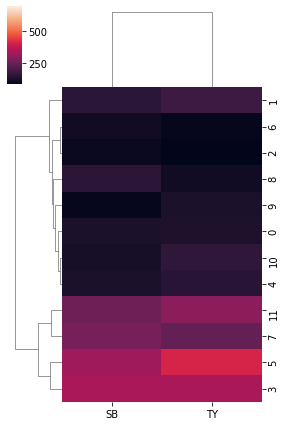

In [42]:
cluster_counts = {}

for ind, row in narrow.loc[narrow['Time Point'] == 'T0'].iterrows():
    if row['Site'] not in cluster_counts:
        cluster_counts[row['Site']] = {}
    if row['Cluster'] not in cluster_counts[row['Site']]:
        cluster_counts[row['Site']][row['Cluster']] = 0
    cluster_counts[row['Site']][row['Cluster']] += 1
        
cluster_counts = pd.DataFrame(cluster_counts)  

sns.clustermap(cluster_counts,vmax=700,figsize=(4,6))

In [47]:
cluster_shifts = pd.DataFrame(columns=['ASV','Core','Tank','Site','CTCN','CTN','TCN','TN'])
cluster_shifts = {}

df = pd.read_csv('asv_clusters/genus_dynamics_per_tank.tsv',sep='\t',index_col=0)

for ind, row in df.iterrows():
    asv, other = ind.split('~~')
    xx,treatment,tank,site,core = other.split('_')
    if core == 'NotCore':
        continue
    if asv not in cluster_shifts:
        cluster_shifts[asv] = {}
    if tank not in cluster_shifts[asv]:
        cluster_shifts[asv][tank] = {}
    if core not in cluster_shifts[asv][tank]:
        cluster_shifts[asv][tank][core] = {}
    if site not in cluster_shifts[asv][tank][core]:
        cluster_shifts[asv][tank][core][site] = {}
    cluster_shifts[asv][tank][core][site][treatment] = row['label'] 

In [48]:
asv_dynamics = pd.DataFrame(columns=['ASV','Tank','Core','Site','Treatment','Cluster'])
for asv in cluster_shifts:
    for tank in cluster_shifts[asv]:
        for core in cluster_shifts[asv][tank]:
            for site in cluster_shifts[asv][tank][core]:
                for treatment in cluster_shifts[asv][tank][core][site]:
                    asv_dynamics.loc[len(asv_dynamics)] = [asv,tank,core,site,treatment,cluster_shifts[asv][tank][core][site][treatment]]
asv_dynamics.index.name = 'sample-id'
asv_dynamics.to_csv('asv_clusters/genus_dynamics.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file asv_clusters/genus_dynamics.tsv \
    --p-formula "Cluster ~ Site + Treatment + Core" \
    --o-visualization asv_clusters/genus_dynamics.qzv

Saved Visualization to: asv_clusters/genus_dynamics.qzv


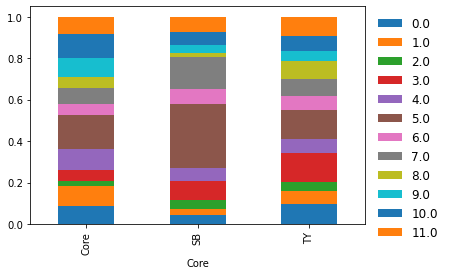

In [73]:
pivot = pd.pivot_table(asv_dynamics,index='Core',columns='Cluster',aggfunc='count',values='ASV')
pivot = pivot.div(pivot.sum(axis=1), axis=0)
fig, ax = plt.subplots()
pivot.plot.bar(stacked=True,legend=False,ax=ax)
ax.legend(loc=1,bbox_to_anchor=(1.25,1),fontsize=12,frameon=False)

In [74]:
import numpy as np
from scipy.stats import chi2_contingency

c, p, dof, expected = chi2_contingency(pivot.transpose()) 
p

1.0

In [45]:
df = pd.read_csv('asv_clusters/genus_dynamics_per_tank.tsv',sep='\t',index_col=0)

In [4]:
def get_treat(string):
    return string.split('_')[1]

df['treatment'] = df.index.map(get_treat)

In [16]:
heatmap = df.loc[:,['treatment','label','T0']].pivot_table(index='treatment',columns='label',aggfunc='count')

In [23]:
heatmap.columns

MultiIndex([('T0',  0),
            ('T0',  1),
            ('T0',  2),
            ('T0',  3),
            ('T0',  4),
            ('T0',  5),
            ('T0',  6),
            ('T0',  7),
            ('T0',  8),
            ('T0',  9),
            ('T0', 10),
            ('T0', 11)],
           names=[None, 'label'])

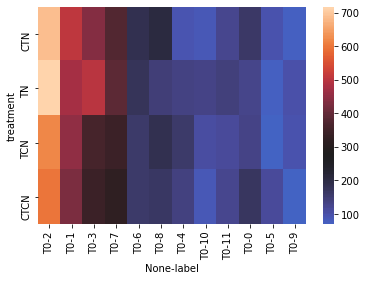

In [29]:
sns.heatmap(heatmap.loc[['CTN','TN','TCN','CTCN'],[('T0',i) for i in [2,1,3,7,6,8,4,10,11,0,5,9]]],center=280)

In [30]:
import numpy as np
from scipy.stats import chi2_contingency

In [31]:
c, p, dof, expected = chi2_contingency(heatmap) 

In [32]:
p

2.564261534827653e-10

In [37]:
def get_site(string):
    return string.split('_')[3]

df['site'] = df.index.map(get_site)

In [38]:
heatmap = df.loc[:,['site','label','T0']].pivot_table(index='site',columns='label',aggfunc='count')

In [39]:
c, p, dof, expected = chi2_contingency(heatmap) 

In [40]:
p

0.004996808572814956

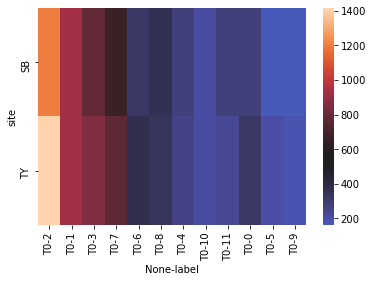

In [42]:
sns.heatmap(heatmap.loc[:,[('T0',i) for i in [2,1,3,7,6,8,4,10,11,0,5,9]]],center=550)

In [47]:
def get_asv(string):
    return string.split('_')[0]

df['asv'] = df.index.map(get_asv)

In [52]:
heatmap = df.loc[:,['asv','label','T0']].pivot_table(index='asv',columns='label',aggfunc='count').fillna(0)

In [53]:
c, p, dof, expected = chi2_contingency(heatmap) 

In [54]:
p

1.9986367011e-313

In [55]:
heatmap

T0                                       \
label                              0    1     2    3    4    5     6    7    
asv                                                                          
000d8774ae6cb87b2f832c7db76405d7  0.0  1.0   0.0  0.0  0.0  0.0   0.0  0.0   
004494479eb8cbe83db7074d87eac0d2  0.0  0.0  12.0  0.0  0.0  4.0  10.0  4.0   
006f2c4a7ee4d1e261919ce6da0aac94  0.0  0.0   0.0  1.0  0.0  0.0   0.0  0.0   
0073dee2f4ae833b2aa2c02a09521d87  0.0  0.0   0.0  1.0  0.0  0.0   0.0  0.0   
007f129567768d5ac6b7cb169d7894ff  0.0  2.0   0.0  1.0  0.0  0.0   0.0  0.0   
...                               ...  ...   ...  ...  ...  ...   ...  ...   
ff8ce96577ad2fec887e2ee60258a027  0.0  0.0   0.0  0.0  1.0  0.0   0.0  0.0   
ff9a782174c011e062a2a911e5003b8e  0.0  0.0   0.0  0.0  0.0  0.0   0.0  1.0   
ffa8633aa2c0af8242ed5dfca49111e8  0.0  0.0   1.0  0.0  0.0  0.0   0.0  0.0   
ffabc8e7dc6dfae0d49607bcacf04a0f  0.0  0.0   0.0  0.0  1.0  0.0   0.0  1.0   
fffdf6e8b3b80d30e42f13a584f2d075  0.0  2.0   0.0  0.0  0.0  0.0   0.0  0.0   

                                                      
label                              8    9    10   11  
asv                                                   
000d8774ae6cb87b2f832c7db76405d7  0.0  0.0  0.0  0.0  
004494479eb8cbe83db7074d87eac0d2  0.0  2.0  1.0  0.0  
006f2c4a7ee4d1e261919ce6da0aac94  0.0  0.0  0.0  0.0  
0073dee2f4ae833b2aa2c02a09521d87  0.0  0.0  0.0  0.0  
007f129567768d5ac6b7cb169d7894ff  0.0  1.0  0.0  0.0  
...                               ...  ...  ...  ...  
ff8ce96577ad2fec887e2ee60258a027  0.0  0.0  0.0  0.0  
ff9a782174c011e062a2a911e5003b8e  0.0  0.0  0.0  0.0  
ffa8633aa2c0af8242ed5dfca49111e8  0.0  0.0  0.0  0.0  
ffabc8e7dc6dfae0d49607bcacf04a0f  0.0  0.0  0.0  0.0  
fffdf6e8b3b80d30e42f13a584f2d075  0.0  0.0  0.0  0.0  

[2110 rows x 12 columns]

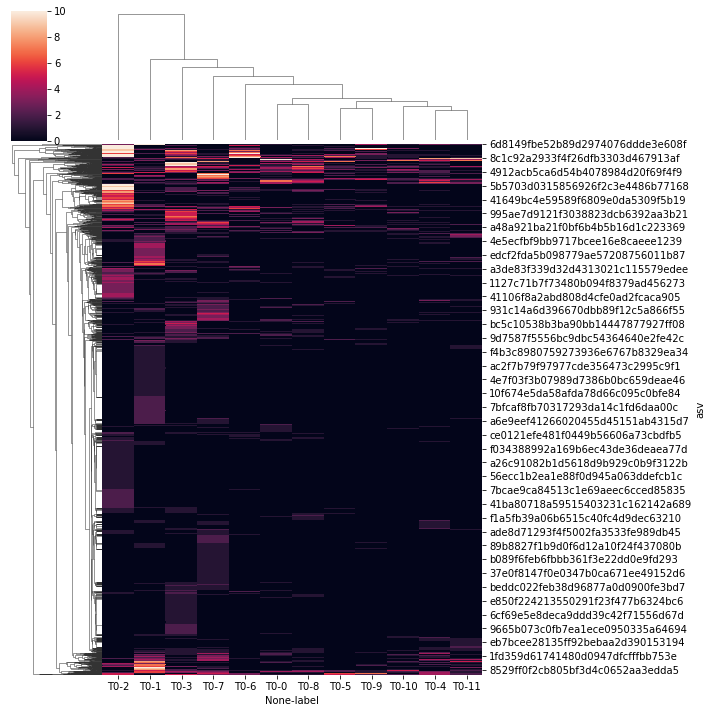

In [58]:
sns.clustermap(heatmap,vmax=10)

In [87]:
df

,T0,T3,T5,T8,label,treatment,site,asv
2710d8e9ad589b6610891acf5ba4c152_TN_tank17_SB_NotCore,0.0,0.000000,0.400000,1.0,11,2710d8e9ad589b6610891acf5ba4c152,SB,2710d8e9ad589b6610891acf5ba4c152
c931281dfd100a624d819509433bdaa6_TN_tank17_SB_NotCore,0.0,0.700000,1.000000,0.2,0,c931281dfd100a624d819509433bdaa6,SB,c931281dfd100a624d819509433bdaa6
f6fa245b65bb965babf8773e0b7ca6c1_TN_tank17_SB_NotCore,0.0,0.230769,0.846154,1.0,4,f6fa245b65bb965babf8773e0b7ca6c1,SB,f6fa245b65bb965babf8773e0b7ca6c1
e7256d3c7b90f634aef83329faec99d8_TN_tank17_SB_NotCore,0.0,1.000000,0.000000,0.0,3,e7256d3c7b90f634aef83329faec99d8,SB,e7256d3c7b90f634aef83329faec99d8
99732d7a1422d9f96131e0ff532a9618_TN_tank17_SB_NotCore,0.0,1.000000,0.600000,0.3,8,99732d7a1422d9f96131e0ff532a9618,SB,99732d7a1422d9f96131e0ff532a9618
...,...,...,...,...,...,...,...,...
f55d29664dc42ad04bc32a89f373cac0_CTN_tank10_TY_NotCore,1.0,0.689655,0.000000,0.0,6,f55d29664dc42ad04bc32a89f373cac0,TY,f55d29664dc42ad04bc32a89f373cac0
a140a836aa5bdcf3db5f507cf27fc955_CTN_tank10_TY_NotCore,0.0,0.000000,1.000000,0.5,4,a140a836aa5bdcf3db5f507cf27fc955,TY,a140a836aa5bdcf3db5f507cf27fc955
0416c65a56ea26c03f6da1ee8a4c44c7_CTN_tank10_TY_NotCore,1.0,0.000000,0.000000,0.0,2,0416c65a56ea26c03f6da1ee8a4c44c7,TY,0416c65a56ea26c03f6da1ee8a4c44c7
38af7c23ec8f722977bda30dcbe912d5_CTN_tank10_TY_NotCore,0.0,1.000000,0.000000,0.0,3,38af7c23ec8f722977bda30dcbe912d5,TY,38af7c23ec8f722977bda30dcbe912d5


In [67]:
taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)


new_index = []

for i in heatmap.index:

    asv = taxa.at[i,'Taxon']

    taxline = asv.split(';')
    tax = taxline.pop(-1)
    if 'Unassigned' in asv:
        new_index.append(i[:6])
        continue
    while 'Unknown' in tax or 'uncultured' in tax or tax == '__' in tax:
        tax = taxline.pop(-1)
    tax = tax.split('__')[1]

    a = i[:6] + ' ' + tax
    
    new_index.append(a)
heatmap.index = new_index



In [72]:
heatmap['Sum'] = heatmap.sum(axis=1)

In [79]:
heatmap = heatmap.loc[heatmap['Sum'] > 16]

In [82]:
heatmap = heatmap.drop('Sum',axis=1)

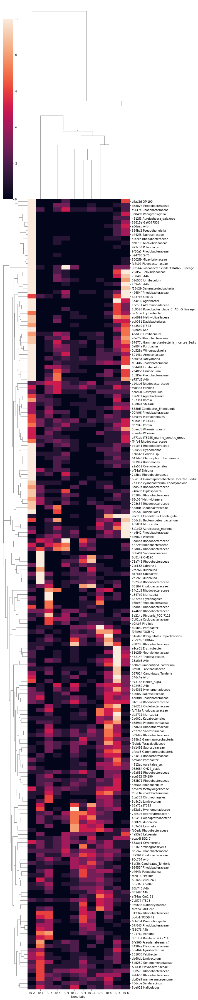

In [86]:
sns.clustermap(heatmap,vmax=10,yticklabels=True,figsize=(10,50))

In [88]:
def get_taxon(i):

    asv = taxa.at[i,'Taxon']

    taxline = asv.split(';')
    tax = taxline.pop(-1)
    if 'Unassigned' in asv:
        return 'Unassigned'
    while 'Unknown' in tax or 'uncultured' in tax or tax == '__' in tax:
        tax = taxline.pop(-1)
    tax = tax.split('__')[1]

    return tax
  
df['taxon'] = df.asv.apply(get_taxon)

In [227]:
heatmap = df.loc[:,['taxon','label','T0']].pivot_table(index='taxon',columns='label',aggfunc='count').fillna(0)

In [221]:
c, p, dof, expected = chi2_contingency(heatmap) 

In [222]:
p

3.3190067640223287e-274

In [228]:
heatmap['Sum'] = heatmap.sum(axis=1)

In [229]:
heatmap = heatmap.loc[heatmap['Sum'] > 10]

In [230]:
heatmap = heatmap.drop('Sum',axis=1)

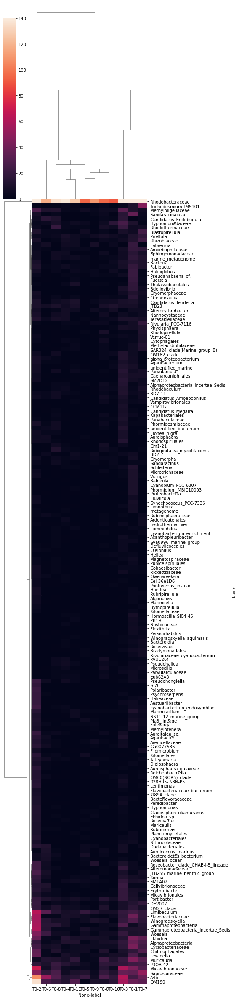

In [233]:
sns.clustermap(heatmap,yticklabels=True,figsize=(8,33),vmax=140)